In [1]:
import os
import tensorflow as tf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

from tqdm import tqdm
from collections import Counter
from utils import *

In [2]:
device = '/device:GPU:0'

# Set up data pipeline:

This GAN uses low resolution (28*28) logos data parsed from the internet. Later logo images were filtered with 
EAST text detector to select logos that contain no text (or minimal text). The resulting dataset has 12180 images in total

In [3]:
!unzip logos_lowres.zip

Archive:  logos_lowres.zip
  inflating: logos_lowres.pkl        


In [3]:
logos_lowres = load_obj('logos_lowres')
logos_lowres.shape

(12180, 28, 28, 3)

In [4]:
IMG_HW = 28
NOISE_DIM = 3
NOISE_C = 10

# Data augumentation:

In order to create more training data, original dataset was augumented with images produced by fliping, rotating and random hue adjustments of the original.

In [5]:
def rand_hue_and_clip(image):
    return tf.clip_by_value(tf.image.random_hue(image, 
                                                max_delta=np.random.uniform(0, 0.5, 1).squeeze()), 
                            -1.0, 1.0)

def augument_logo(img_init):
    imgs_out = []
    imgs_out.append(img_init)
    imgs_out.append(rand_hue_and_clip(tf.image.flip_left_right(img_init)).numpy())
    imgs_out.append(rand_hue_and_clip(tf.image.rot90(img_init, k=1)).numpy())
    imgs_out.append(rand_hue_and_clip(tf.image.rot90(img_init, k=2)).numpy())
    imgs_out.append(rand_hue_and_clip(img_init))
    return np.concatenate(imgs_out, axis=0)

(5, 28, 28, 3)


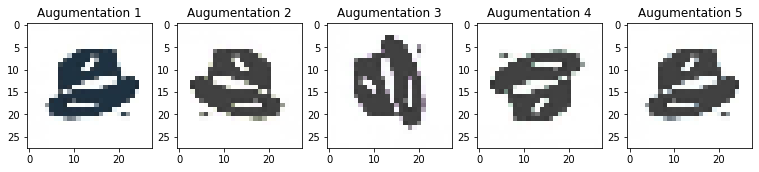

(5, 28, 28, 3)


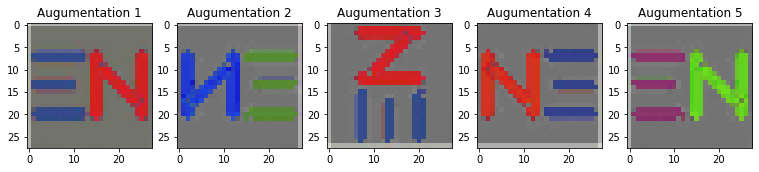

(5, 28, 28, 3)


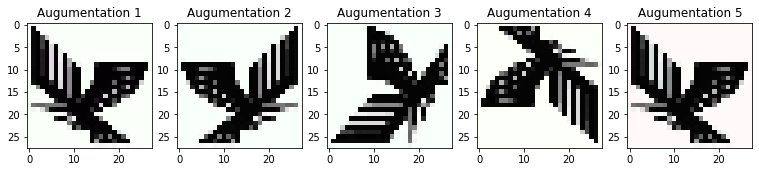

(5, 28, 28, 3)


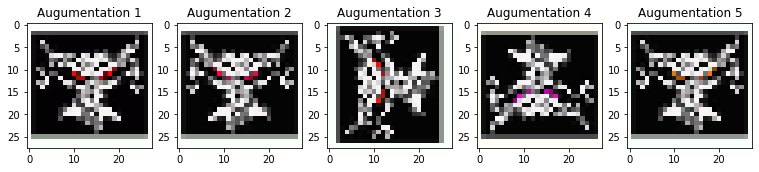

(5, 28, 28, 3)


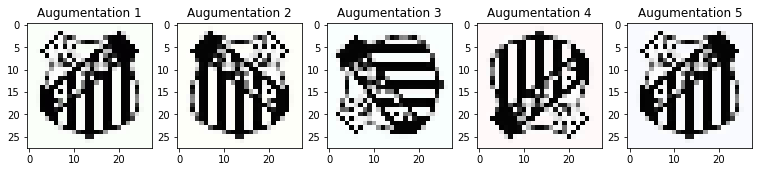

(5, 28, 28, 3)


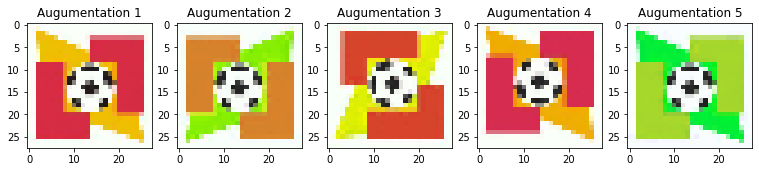

(5, 28, 28, 3)


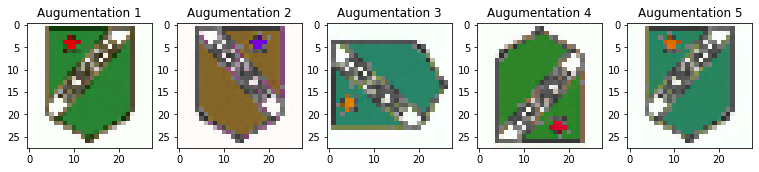

(5, 28, 28, 3)


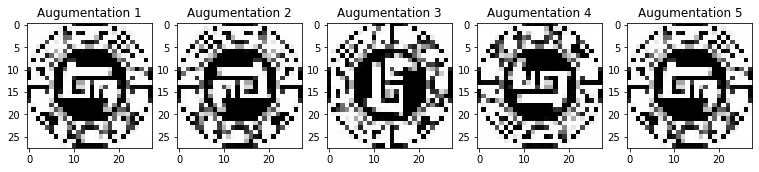

(5, 28, 28, 3)


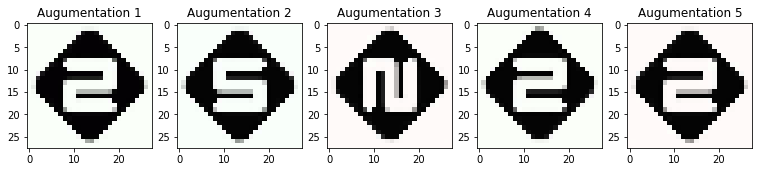

(5, 28, 28, 3)


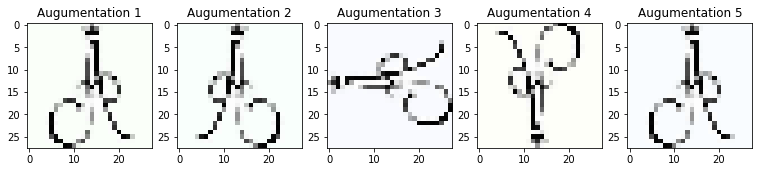

In [11]:
for _ in range(10):
    img_init = logos_lowres[np.random.choice(logos_lowres.shape[0], 1, replace=False)]
    aug_imgs = augument_logo(img_init)
    print(aug_imgs.shape)

    plt.figure(figsize=(13, 3))
    for i, aug_img in enumerate(aug_imgs):
        plt.subplot(1, 5, i+1)
        plt.title(f'Augumentation {i+1}')
        plt.imshow((aug_img+1)/2)
    plt.show()

In [6]:
aug_logos = []
for logo_i in tqdm(range(logos_lowres.shape[0])):
    aug_logos.append(augument_logo(logos_lowres[[logo_i]]))
aug_logos = np.concatenate(aug_logos, axis=0)
print(f'Old data shape: {logos_lowres.shape}, Augumented data shape: {aug_logos.shape}')

100%|██████████| 12180/12180 [01:03<00:00, 192.74it/s]


Old data shape: (12180, 28, 28, 3), Augumented data shape: (60900, 28, 28, 3)


# Converting to tf.data:

In [7]:
# Split dataset into batches:
BATCH_SIZE = 128
train_ds = tf.data.Dataset.from_tensor_slices(aug_logos).shuffle(1024).batch(BATCH_SIZE)

# Defining generator:

In [8]:
# Wrapper for the leaky-relu:
def leaky_relu(x, alpha=0.05):
    return tf.nn.leaky_relu(x, alpha=alpha)

In [9]:
def generator(input_shape):
    
    model = tf.keras.models.Sequential([
        
            tf.keras.layers.Input(input_shape),
            
            tf.keras.layers.Conv2DTranspose(1024, (4,4), strides=(2,2), padding='same',
                                            activation=leaky_relu), #1024
            tf.keras.layers.BatchNormalization(),
            
            tf.keras.layers.Conv2DTranspose(512, (4,4), strides=(2,2), padding='valid',
                                            activation=leaky_relu), #512
            tf.keras.layers.BatchNormalization(),
            
            tf.keras.layers.Conv2DTranspose(256, (4,4), strides=(2,2), padding='same',
                                            activation=leaky_relu), #128
            tf.keras.layers.BatchNormalization(),
            
            tf.keras.layers.Conv2DTranspose(3, (4,4), strides=(1,1), padding='same',
                                            activation='tanh')
        ])
    return model

In [10]:
model = generator([NOISE_DIM, NOISE_DIM, NOISE_C])
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_transpose (Conv2DTran (None, 6, 6, 1024)        164864    
_________________________________________________________________
batch_normalization (BatchNo (None, 6, 6, 1024)        4096      
_________________________________________________________________
conv2d_transpose_1 (Conv2DTr (None, 14, 14, 512)       8389120   
_________________________________________________________________
batch_normalization_1 (Batch (None, 14, 14, 512)       2048      
_________________________________________________________________
conv2d_transpose_2 (Conv2DTr (None, 28, 28, 256)       2097408   
_________________________________________________________________
batch_normalization_2 (Batch (None, 28, 28, 256)       1024      
_________________________________________________________________
conv2d_transpose_3 (Conv2DTr (None, 28, 28, 3)         1

# Defining discriminator:

In [11]:
def discriminator(input_shape):
    model = tf.keras.Sequential([
        tf.keras.layers.Input(input_shape),
        tf.keras.layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same',
                               activation=leaky_relu),
        tf.keras.layers.Dropout(0.3),
        tf.keras.layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same',
                               activation=leaky_relu),
        tf.keras.layers.Dropout(0.3),
        tf.keras.layers.Flatten(),
        tf.keras.layers.Dense(128, activation=leaky_relu),
        tf.keras.layers.Dropout(0.3),
        tf.keras.layers.Dense(1, activation=None)  
    ])
    return model
model = discriminator([IMG_HW, IMG_HW, 3])

In [12]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 14, 14, 64)        4864      
_________________________________________________________________
dropout (Dropout)            (None, 14, 14, 64)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 7, 7, 128)         204928    
_________________________________________________________________
dropout_1 (Dropout)          (None, 7, 7, 128)         0         
_________________________________________________________________
flatten (Flatten)            (None, 6272)              0         
_________________________________________________________________
dense (Dense)                (None, 128)               802944    
_________________________________________________________________
dropout_2 (Dropout)          (None, 128)              

# Set up loss for GAN:

Here, two optins for GAN loss ara available: vanilla GAN loss or least-squares GAN loss. In this example the second option is used for training.

In [13]:
# Vanilla GAN loss
def discriminator_loss(logits_real, logits_fake):
    loss_fn = tf.keras.losses.BinaryCrossentropy(from_logits=True)
    real_labels, fake_labels = tf.ones(logits_real.shape), tf.zeros(logits_fake.shape)
    real_loss = loss_fn(real_labels, logits_real)
    fake_loss = loss_fn(fake_labels, logits_fake)
    loss = tf.math.add(real_loss, fake_loss)
    loss = tf.math.reduce_mean(loss)
    loss = tf.math.multiply(loss, 1)
    return loss

def generator_loss(logits_fake):
    adversarial_loss_fn = tf.keras.losses.BinaryCrossentropy(from_logits=True)
    fake_labels = tf.ones(logits_fake.shape)
    adversarial_loss = adversarial_loss_fn(fake_labels, logits_fake)
    return adversarial_loss

In [14]:
# Least Squares GAN loss
def ls_discriminator_loss(scores_real, scores_fake):  
    real_loss = tf.math.square(tf.math.subtract(scores_real, 1))
    real_loss = tf.math.multiply(0.5, tf.math.reduce_mean(real_loss))
    fake_loss = tf.math.square(scores_fake)
    fake_loss = tf.math.multiply(0.5, tf.math.reduce_mean(fake_loss))
    loss = tf.math.add(real_loss, fake_loss)    
    return loss

def ls_generator_loss(scores_fake):
    loss = tf.math.subtract(scores_fake, 1)
    loss = tf.math.reduce_mean(tf.math.square(loss))
    loss = tf.math.multiply(0.5, loss)
    return loss

# Looking at augumented reals:

In [15]:
def show_tf_batch(tf_batch, imtype='rgb', n_img = 25, to_print=None):
    images = tf_batch.numpy()
    images = (images + 1) / 2
    sqrtn = int(np.ceil(np.sqrt(n_img)))
    # select subset
    images = images[:n_img]
    # set grid
    fig = plt.figure(figsize=(sqrtn, sqrtn))
    gs = gridspec.GridSpec(sqrtn, sqrtn)
    gs.update(wspace=0.05, hspace=0.05)
    
    for i, img in enumerate(images):
        ax = plt.subplot(gs[i])
        plt.axis('off')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.set_aspect('equal')        
        if imtype == 'rgb':
            plt.imshow(img)
        else:
            plt.imshow(img[:, :, 0], cmap='gray')
    if to_print is not None:
        print(to_print)
    return

tf.Tensor([128  28  28   3], shape=(4,), dtype=int32)


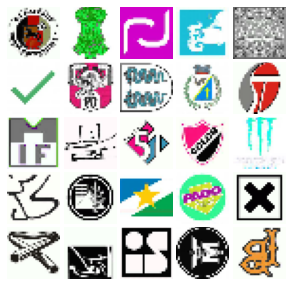

tf.Tensor([128  28  28   3], shape=(4,), dtype=int32)


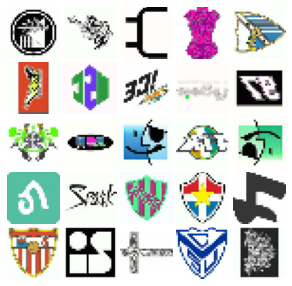

tf.Tensor([128  28  28   3], shape=(4,), dtype=int32)


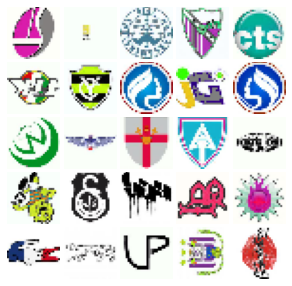

tf.Tensor([128  28  28   3], shape=(4,), dtype=int32)


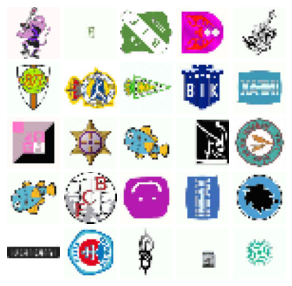

In [16]:
max_print = 3
counter = 0
for data_batch in train_ds:
    counter += 1
    real_imgs = data_batch
    print(tf.shape(real_imgs))
    show_tf_batch(real_imgs)
    plt.show()
    if counter > max_print:
        break

# Specify GAN training loop:

Here, GAN class defines methods for running training loop as well as some utils for creating and restoring checkpoints.

In [17]:
class GANSolver(object):
    
    def __init__(self, G, D, G_loss, D_loss, G_solver, D_solver):
        self.G = G
        self.D = D
        self.G_loss = G_loss
        self.D_loss = D_loss
        self.G_solver = G_solver
        self.D_solver = D_solver
        
        self.checkpoint_prefix = None
        self.checkpoint = None
        
    
    def create_checkpoint(self, cp_path):
        
        self.checkpoint_prefix = os.path.join(cp_path, "ckpt")
        self.checkpoint = tf.train.Checkpoint(generator_optimizer=self.G_solver,
                                              discriminator_optimizer=self.D_solver,
                                              generator=self.G,
                                              discriminator=self.D)
        
    def restore_checkpoint(self, cp_path):
        
        if self.checkpoint is None:
            self.create_checkpoint(cp_path=cp_path)
            
        self.checkpoint.restore(tf.train.latest_checkpoint(cp_path)).expect_partial()
        
        self.G = self.checkpoint.generator
        self.D = self.checkpoint.discriminator
        self.G_solver = self.checkpoint.generator_optimizer
        self.D_solver = self.checkpoint.discriminator_optimizer
        
    
    def train(self, train_data, num_epochs, show_every=50, cp_path=None):
        
        if cp_path is not None:
            self.create_checkpoint(cp_path=cp_path)
        
        for ep in range(num_epochs):     
            iter_counter = 0
            for data_batch in train_data:
                noise, real_imgs = tf.random.uniform([BATCH_SIZE, NOISE_DIM, NOISE_DIM, NOISE_C], 
                                                     minval=-1.0,
                                                     maxval=1.0), data_batch
                with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
                    real_logits = self.D(real_imgs, training=True)
                    fake_imgs = self.G(noise, training=True)
                    fake_logits = self.D(fake_imgs, training=True)
                    # Updating generator:
                    gen_loss = self.G_loss(fake_logits)
                    gen_grads = gen_tape.gradient(gen_loss, self.G.trainable_variables)
                    self.G_solver.apply_gradients(zip(gen_grads, self.G.trainable_variables))
                    # Updating discriminator:
                    disc_loss = self.D_loss(real_logits, fake_logits)
                    disc_grads = disc_tape.gradient(disc_loss, self.D.trainable_variables)
                    self.D_solver.apply_gradients(zip(disc_grads, self.D.trainable_variables))
                    
                iter_counter += 1
                if iter_counter % show_every == 0:
                    print(f'Epoch: {ep}, Iter: {iter_counter}, D: {disc_loss}, G:{gen_loss}')
                    show_tf_batch(fake_imgs, n_img=25)
                    plt.show()
                    
            if self.checkpoint is not None:
                print(f'Saving GAN to {cp_path}, epoch No. {ep}')
                self.checkpoint.save(file_prefix=self.checkpoint_prefix)

In [18]:
album_gan = GANSolver(G=generator([NOISE_DIM, NOISE_DIM, NOISE_C]),
                      D=discriminator([IMG_HW, IMG_HW, 3]),
                      G_loss=ls_generator_loss,
                      D_loss=ls_discriminator_loss,
                      G_solver=tf.keras.optimizers.Adam(lr=0.0002, beta_1=0.5),
                      D_solver=tf.keras.optimizers.Adam(lr=0.0002, beta_1=0.5)) # SGD if no dropout in D

In [19]:
print(f'Est epoch size: {aug_logos.shape[0] / BATCH_SIZE} iterations')

Est epoch size: 475.78125 iterations


In [26]:
# Start from previous checkpoint if needed:
# This checkpoint data was too large for Githhub

# album_gan.restore_checkpoint('./lch500')

Epoch: 0, Iter: 460, D: 0.10719862580299377, G:0.29574882984161377


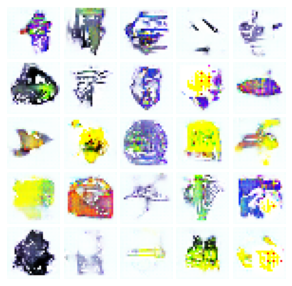

Saving GAN to ./logos_checkpoints2, epoch No. 0
Epoch: 1, Iter: 460, D: 0.10946939885616302, G:0.41423919796943665


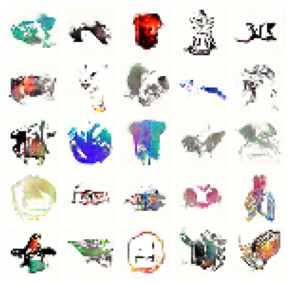

Saving GAN to ./logos_checkpoints2, epoch No. 1
Epoch: 2, Iter: 460, D: 0.08562737703323364, G:0.3375435471534729


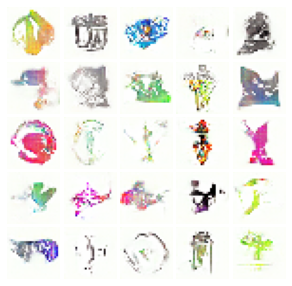

Saving GAN to ./logos_checkpoints2, epoch No. 2
Epoch: 3, Iter: 460, D: 0.07655852288007736, G:0.3476770222187042


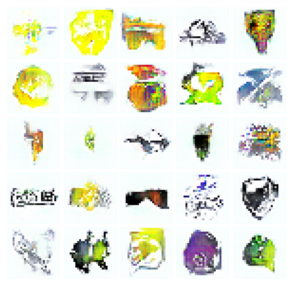

Saving GAN to ./logos_checkpoints2, epoch No. 3
Epoch: 4, Iter: 460, D: 0.09978789836168289, G:0.3713589012622833


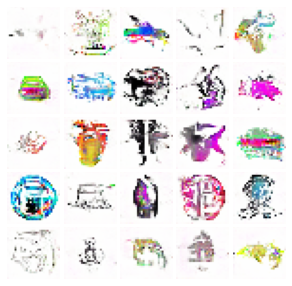

Saving GAN to ./logos_checkpoints2, epoch No. 4
Epoch: 5, Iter: 460, D: 0.09230642765760422, G:0.32945752143859863


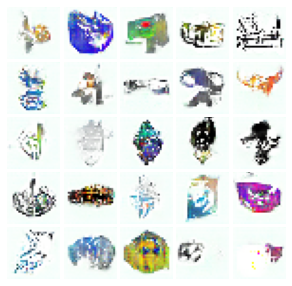

Saving GAN to ./logos_checkpoints2, epoch No. 5
Epoch: 6, Iter: 460, D: 0.06674814224243164, G:0.3888104557991028


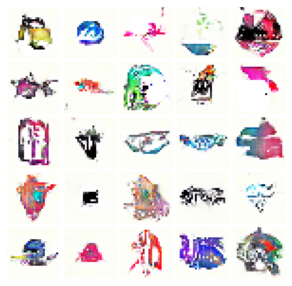

Saving GAN to ./logos_checkpoints2, epoch No. 6
Epoch: 7, Iter: 460, D: 0.08287158608436584, G:0.3761540651321411


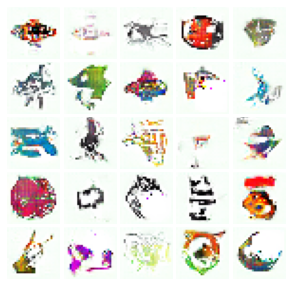

Saving GAN to ./logos_checkpoints2, epoch No. 7
Epoch: 8, Iter: 460, D: 0.0889258086681366, G:0.348993718624115


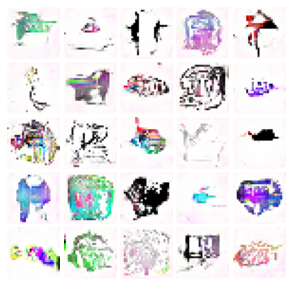

Saving GAN to ./logos_checkpoints2, epoch No. 8
Epoch: 9, Iter: 460, D: 0.09712782502174377, G:0.34582746028900146


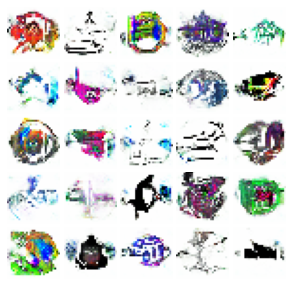

Saving GAN to ./logos_checkpoints2, epoch No. 9
Epoch: 10, Iter: 460, D: 0.09911062568426132, G:0.350965678691864


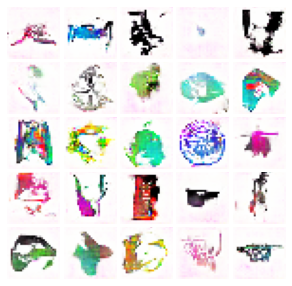

Saving GAN to ./logos_checkpoints2, epoch No. 10
Epoch: 11, Iter: 460, D: 0.09076352417469025, G:0.27339112758636475


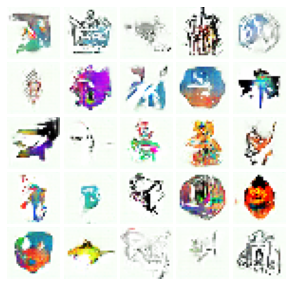

Saving GAN to ./logos_checkpoints2, epoch No. 11
Epoch: 12, Iter: 460, D: 0.10548538714647293, G:0.30047017335891724


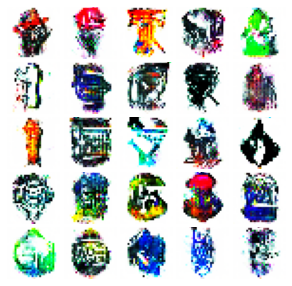

Saving GAN to ./logos_checkpoints2, epoch No. 12
Epoch: 13, Iter: 460, D: 0.1036611795425415, G:0.33560746908187866


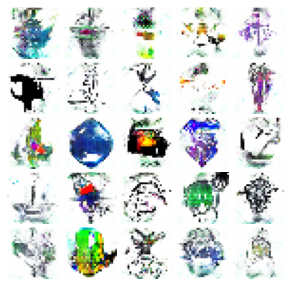

Saving GAN to ./logos_checkpoints2, epoch No. 13
Epoch: 14, Iter: 460, D: 0.07651055604219437, G:0.36538928747177124


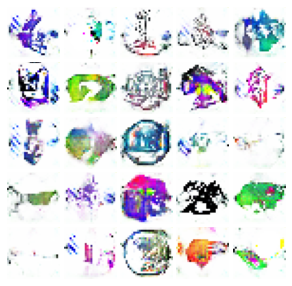

Saving GAN to ./logos_checkpoints2, epoch No. 14
Epoch: 15, Iter: 460, D: 0.07903773337602615, G:0.3639882206916809


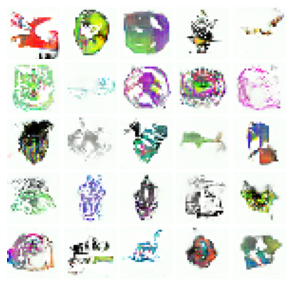

Saving GAN to ./logos_checkpoints2, epoch No. 15
Epoch: 16, Iter: 460, D: 0.08110997825860977, G:0.36283445358276367


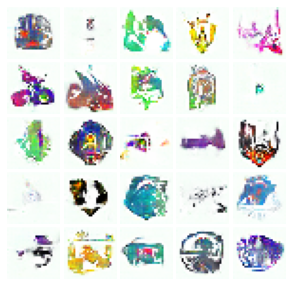

Saving GAN to ./logos_checkpoints2, epoch No. 16
Epoch: 17, Iter: 460, D: 0.08424333482980728, G:0.32894882559776306


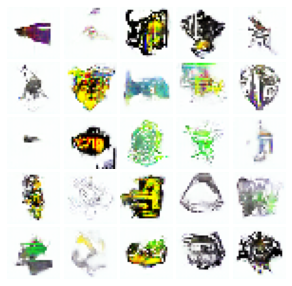

Saving GAN to ./logos_checkpoints2, epoch No. 17
Epoch: 18, Iter: 460, D: 0.09775382280349731, G:0.29822349548339844


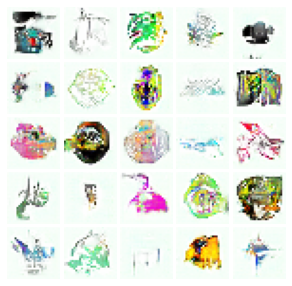

Saving GAN to ./logos_checkpoints2, epoch No. 18
Epoch: 19, Iter: 460, D: 0.10542139410972595, G:0.42081427574157715


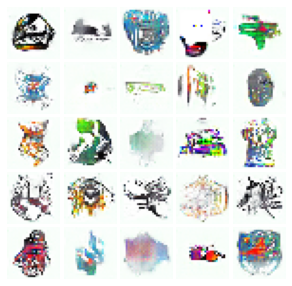

Saving GAN to ./logos_checkpoints2, epoch No. 19
Epoch: 20, Iter: 460, D: 0.10061846673488617, G:0.29355037212371826


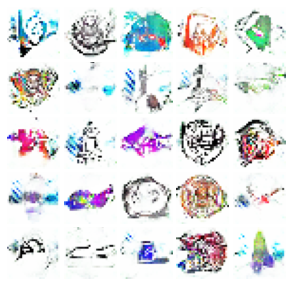

Saving GAN to ./logos_checkpoints2, epoch No. 20
Epoch: 21, Iter: 460, D: 0.08915363252162933, G:0.34381166100502014


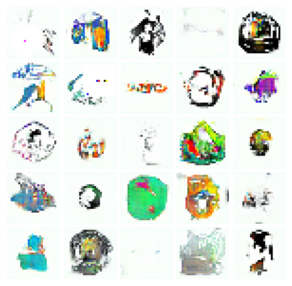

Saving GAN to ./logos_checkpoints2, epoch No. 21
Epoch: 22, Iter: 460, D: 0.0811033546924591, G:0.340751051902771


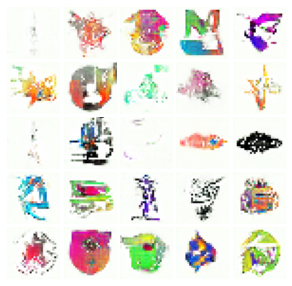

Saving GAN to ./logos_checkpoints2, epoch No. 22
Epoch: 23, Iter: 460, D: 0.06884448230266571, G:0.38073498010635376


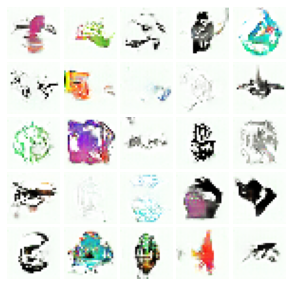

Saving GAN to ./logos_checkpoints2, epoch No. 23
Epoch: 24, Iter: 460, D: 0.07583993673324585, G:0.3221653699874878


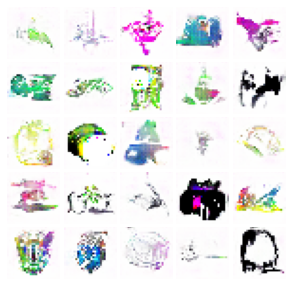

Saving GAN to ./logos_checkpoints2, epoch No. 24
Epoch: 25, Iter: 460, D: 0.09452524781227112, G:0.3177454471588135


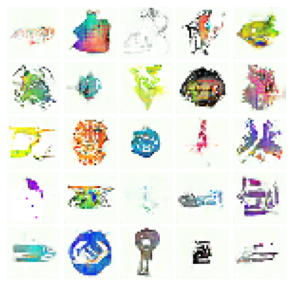

Saving GAN to ./logos_checkpoints2, epoch No. 25
Epoch: 26, Iter: 460, D: 0.07472186535596848, G:0.3722952604293823


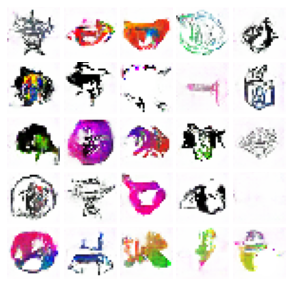

Saving GAN to ./logos_checkpoints2, epoch No. 26
Epoch: 27, Iter: 460, D: 0.07341359555721283, G:0.39110004901885986


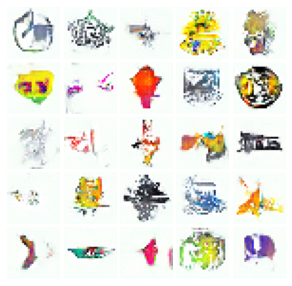

Saving GAN to ./logos_checkpoints2, epoch No. 27
Epoch: 28, Iter: 460, D: 0.06565899401903152, G:0.3365173637866974


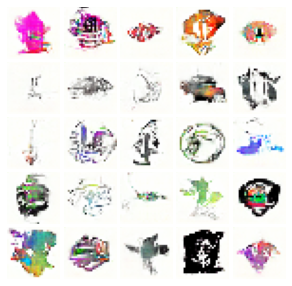

Saving GAN to ./logos_checkpoints2, epoch No. 28
Epoch: 29, Iter: 460, D: 0.07444144040346146, G:0.36204832792282104


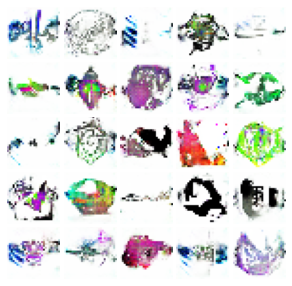

Saving GAN to ./logos_checkpoints2, epoch No. 29
Epoch: 30, Iter: 460, D: 0.07339087128639221, G:0.3933566212654114


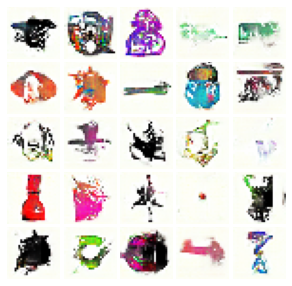

Saving GAN to ./logos_checkpoints2, epoch No. 30
Epoch: 31, Iter: 460, D: 0.08147911727428436, G:0.3342495858669281


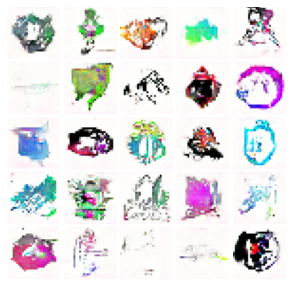

Saving GAN to ./logos_checkpoints2, epoch No. 31
Epoch: 32, Iter: 460, D: 0.09008627384901047, G:0.4075360894203186


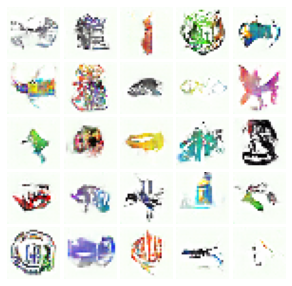

Saving GAN to ./logos_checkpoints2, epoch No. 32
Epoch: 33, Iter: 460, D: 0.07717350125312805, G:0.36522090435028076


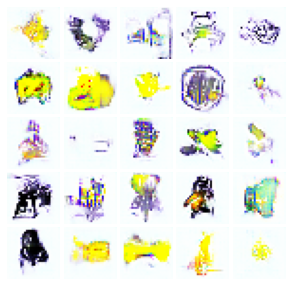

Saving GAN to ./logos_checkpoints2, epoch No. 33
Epoch: 34, Iter: 460, D: 0.0758475735783577, G:0.3874172866344452


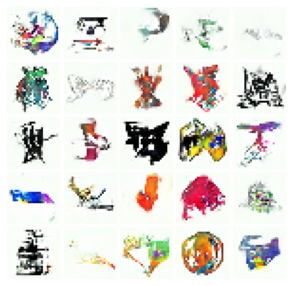

Saving GAN to ./logos_checkpoints2, epoch No. 34
Epoch: 35, Iter: 460, D: 0.07906240224838257, G:0.4266211688518524


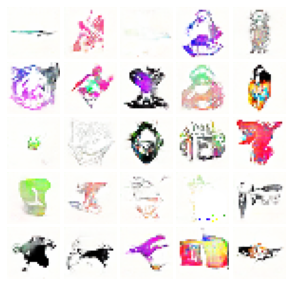

Saving GAN to ./logos_checkpoints2, epoch No. 35
Epoch: 36, Iter: 460, D: 0.10615664720535278, G:0.4787014424800873


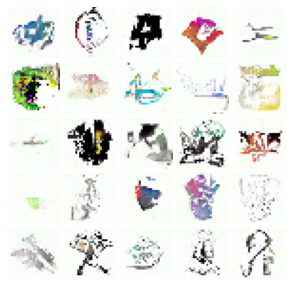

Saving GAN to ./logos_checkpoints2, epoch No. 36
Epoch: 37, Iter: 460, D: 0.07736695557832718, G:0.37182003259658813


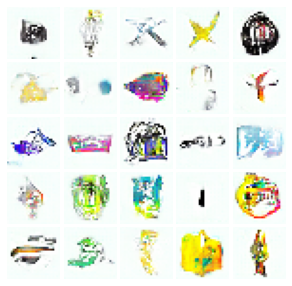

Saving GAN to ./logos_checkpoints2, epoch No. 37
Epoch: 38, Iter: 460, D: 0.08882377296686172, G:0.32612818479537964


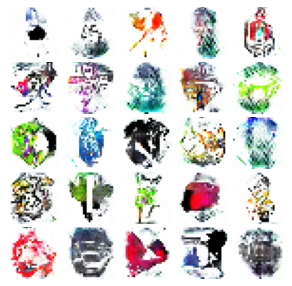

Saving GAN to ./logos_checkpoints2, epoch No. 38
Epoch: 39, Iter: 460, D: 0.0829504132270813, G:0.30538827180862427


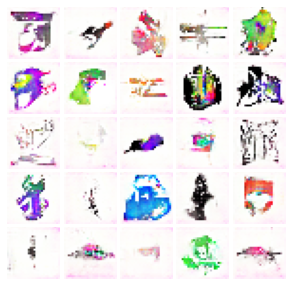

Saving GAN to ./logos_checkpoints2, epoch No. 39
Epoch: 40, Iter: 460, D: 0.09761698544025421, G:0.3947969973087311


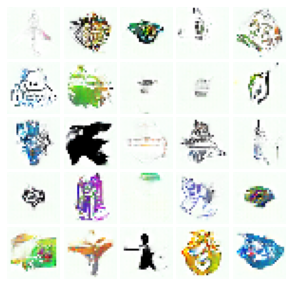

Saving GAN to ./logos_checkpoints2, epoch No. 40
Epoch: 41, Iter: 460, D: 0.07262058556079865, G:0.34274062514305115


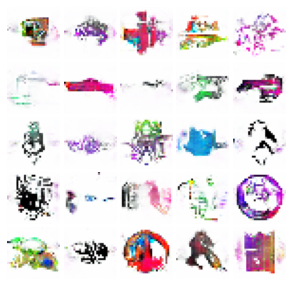

Saving GAN to ./logos_checkpoints2, epoch No. 41
Epoch: 42, Iter: 460, D: 0.07998563349246979, G:0.37853389978408813


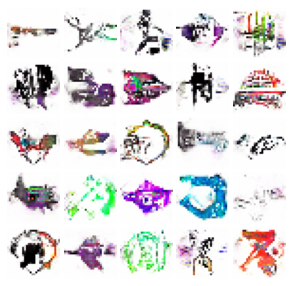

Saving GAN to ./logos_checkpoints2, epoch No. 42
Epoch: 43, Iter: 460, D: 0.0996970534324646, G:0.3217736482620239


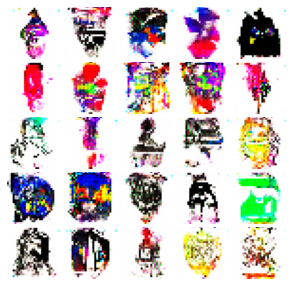

Saving GAN to ./logos_checkpoints2, epoch No. 43
Epoch: 44, Iter: 460, D: 0.09212195873260498, G:0.28226834535598755


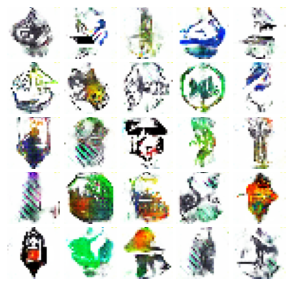

Saving GAN to ./logos_checkpoints2, epoch No. 44
Epoch: 45, Iter: 460, D: 0.07266184687614441, G:0.40137702226638794


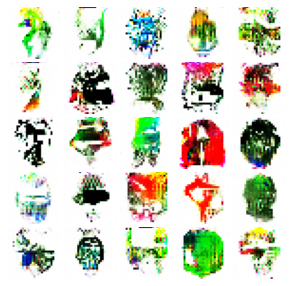

Saving GAN to ./logos_checkpoints2, epoch No. 45
Epoch: 46, Iter: 460, D: 0.10509030520915985, G:0.26928621530532837


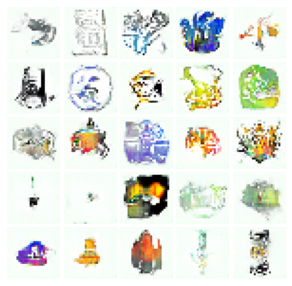

Saving GAN to ./logos_checkpoints2, epoch No. 46
Epoch: 47, Iter: 460, D: 0.08872965723276138, G:0.3493555188179016


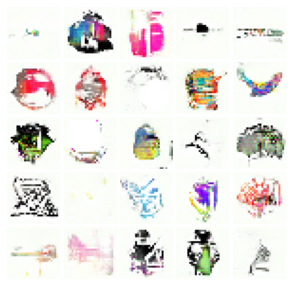

Saving GAN to ./logos_checkpoints2, epoch No. 47
Epoch: 48, Iter: 460, D: 0.08583353459835052, G:0.39091575145721436


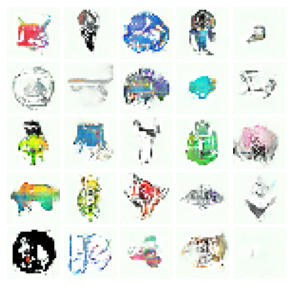

Saving GAN to ./logos_checkpoints2, epoch No. 48
Epoch: 49, Iter: 460, D: 0.09143770486116409, G:0.3055683970451355


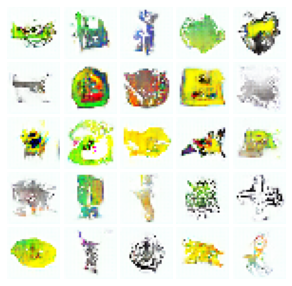

Saving GAN to ./logos_checkpoints2, epoch No. 49
Epoch: 50, Iter: 460, D: 0.08215076476335526, G:0.4172321557998657


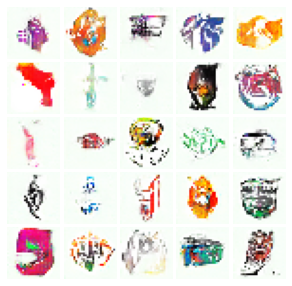

Saving GAN to ./logos_checkpoints2, epoch No. 50
Epoch: 51, Iter: 460, D: 0.10777582228183746, G:0.30579474568367004


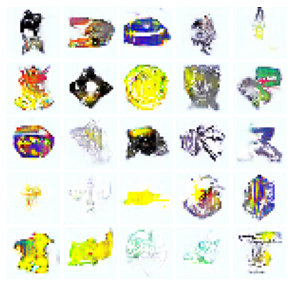

Saving GAN to ./logos_checkpoints2, epoch No. 51
Epoch: 52, Iter: 460, D: 0.09341172873973846, G:0.266735702753067


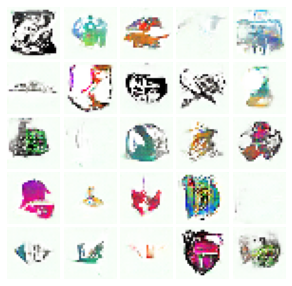

Saving GAN to ./logos_checkpoints2, epoch No. 52
Epoch: 53, Iter: 460, D: 0.09098432958126068, G:0.42730361223220825


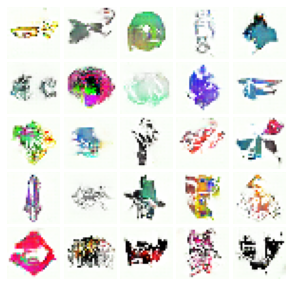

Saving GAN to ./logos_checkpoints2, epoch No. 53
Epoch: 54, Iter: 460, D: 0.09023400396108627, G:0.4713062644004822


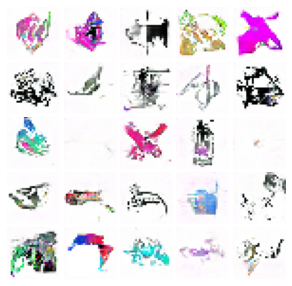

Saving GAN to ./logos_checkpoints2, epoch No. 54
Epoch: 55, Iter: 460, D: 0.08603383600711823, G:0.36447352170944214


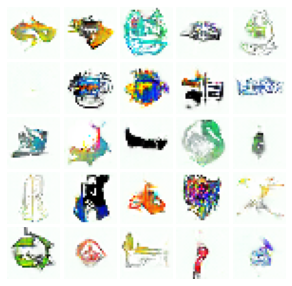

Saving GAN to ./logos_checkpoints2, epoch No. 55
Epoch: 56, Iter: 460, D: 0.08443865925073624, G:0.3051776587963104


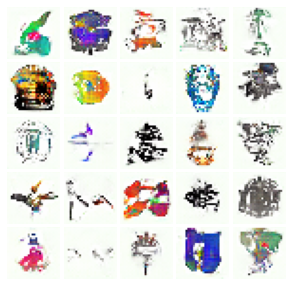

Saving GAN to ./logos_checkpoints2, epoch No. 56
Epoch: 57, Iter: 460, D: 0.06977464258670807, G:0.35117629170417786


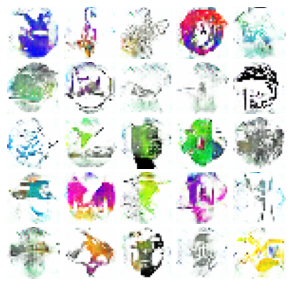

Saving GAN to ./logos_checkpoints2, epoch No. 57
Epoch: 58, Iter: 460, D: 0.07895207405090332, G:0.3908529281616211


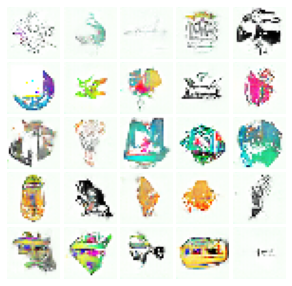

Saving GAN to ./logos_checkpoints2, epoch No. 58
Epoch: 59, Iter: 460, D: 0.08881352841854095, G:0.33881062269210815


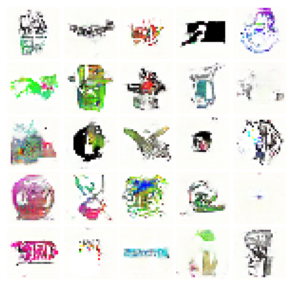

Saving GAN to ./logos_checkpoints2, epoch No. 59
Epoch: 60, Iter: 460, D: 0.0955267995595932, G:0.26829832792282104


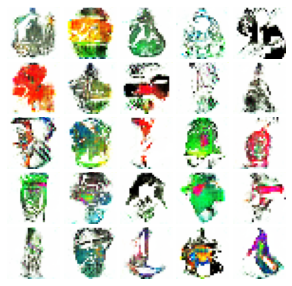

Saving GAN to ./logos_checkpoints2, epoch No. 60
Epoch: 61, Iter: 460, D: 0.07480814307928085, G:0.41542643308639526


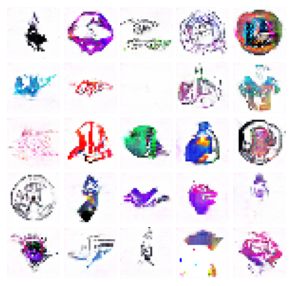

Saving GAN to ./logos_checkpoints2, epoch No. 61
Epoch: 62, Iter: 460, D: 0.08054488897323608, G:0.37752094864845276


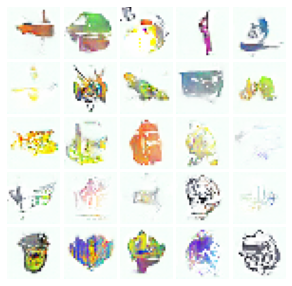

Saving GAN to ./logos_checkpoints2, epoch No. 62
Epoch: 63, Iter: 460, D: 0.09480729699134827, G:0.2974308729171753


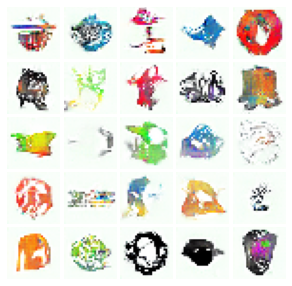

Saving GAN to ./logos_checkpoints2, epoch No. 63
Epoch: 64, Iter: 460, D: 0.09022220224142075, G:0.30923008918762207


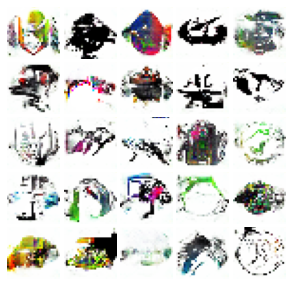

Saving GAN to ./logos_checkpoints2, epoch No. 64
Epoch: 65, Iter: 460, D: 0.09123730659484863, G:0.3636993169784546


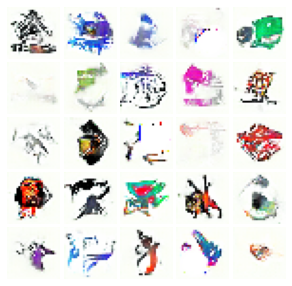

Saving GAN to ./logos_checkpoints2, epoch No. 65
Epoch: 66, Iter: 460, D: 0.06333162635564804, G:0.3870078921318054


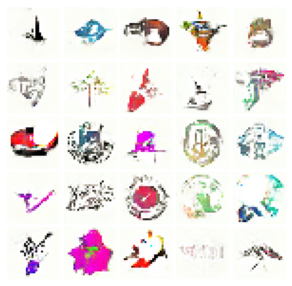

Saving GAN to ./logos_checkpoints2, epoch No. 66
Epoch: 67, Iter: 460, D: 0.07881929725408554, G:0.35514259338378906


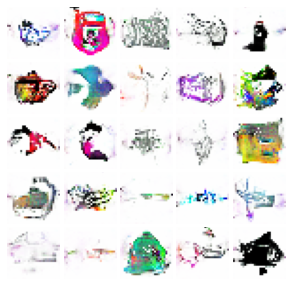

Saving GAN to ./logos_checkpoints2, epoch No. 67
Epoch: 68, Iter: 460, D: 0.07777877151966095, G:0.4018290638923645


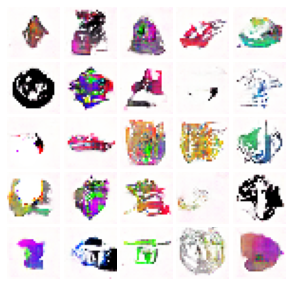

Saving GAN to ./logos_checkpoints2, epoch No. 68
Epoch: 69, Iter: 460, D: 0.08173020929098129, G:0.37239497900009155


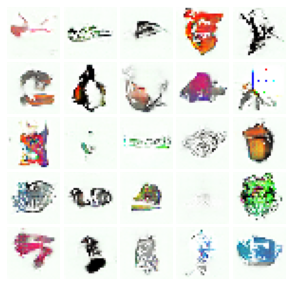

Saving GAN to ./logos_checkpoints2, epoch No. 69
Epoch: 70, Iter: 460, D: 0.09599658846855164, G:0.4354078769683838


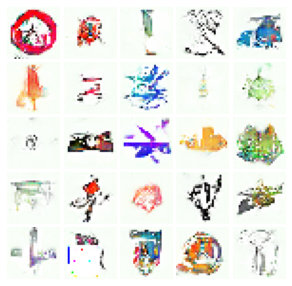

Saving GAN to ./logos_checkpoints2, epoch No. 70
Epoch: 71, Iter: 460, D: 0.08327899128198624, G:0.47391265630722046


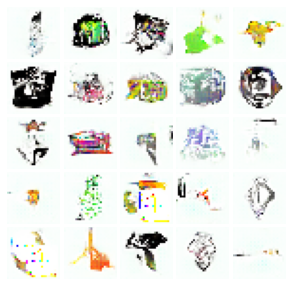

Saving GAN to ./logos_checkpoints2, epoch No. 71
Epoch: 72, Iter: 460, D: 0.09024448692798615, G:0.37276074290275574


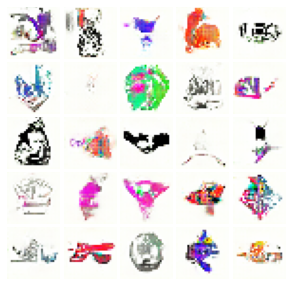

Saving GAN to ./logos_checkpoints2, epoch No. 72
Epoch: 73, Iter: 460, D: 0.06562760472297668, G:0.3429805040359497


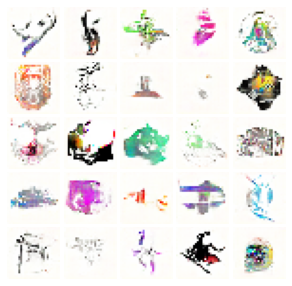

Saving GAN to ./logos_checkpoints2, epoch No. 73
Epoch: 74, Iter: 460, D: 0.08900591731071472, G:0.46074098348617554


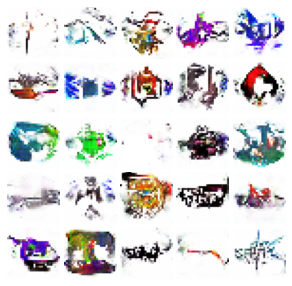

Saving GAN to ./logos_checkpoints2, epoch No. 74
Epoch: 75, Iter: 460, D: 0.08511777222156525, G:0.3815777897834778


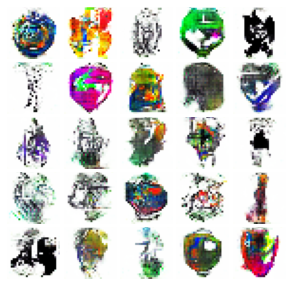

Saving GAN to ./logos_checkpoints2, epoch No. 75
Epoch: 76, Iter: 460, D: 0.08654122054576874, G:0.33654841780662537


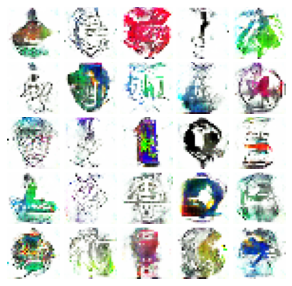

Saving GAN to ./logos_checkpoints2, epoch No. 76
Epoch: 77, Iter: 460, D: 0.0738455057144165, G:0.3670097589492798


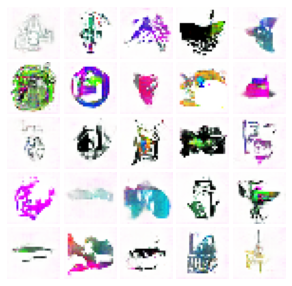

Saving GAN to ./logos_checkpoints2, epoch No. 77
Epoch: 78, Iter: 460, D: 0.06577187031507492, G:0.422757625579834


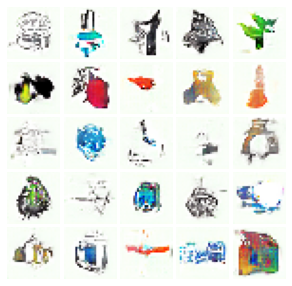

Saving GAN to ./logos_checkpoints2, epoch No. 78
Epoch: 79, Iter: 460, D: 0.09272383153438568, G:0.4099055826663971


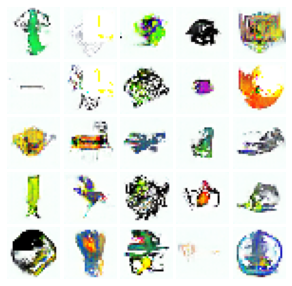

Saving GAN to ./logos_checkpoints2, epoch No. 79
Epoch: 80, Iter: 460, D: 0.086125448346138, G:0.38866230845451355


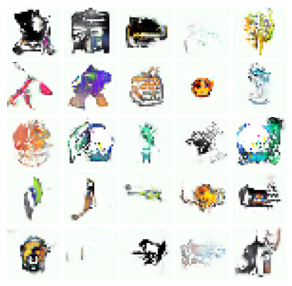

Saving GAN to ./logos_checkpoints2, epoch No. 80
Epoch: 81, Iter: 460, D: 0.08733173459768295, G:0.3742557168006897


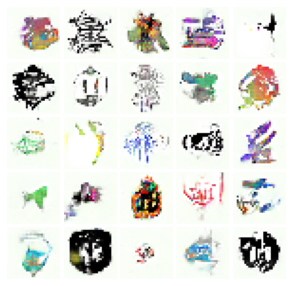

Saving GAN to ./logos_checkpoints2, epoch No. 81
Epoch: 82, Iter: 460, D: 0.08021700382232666, G:0.4335111379623413


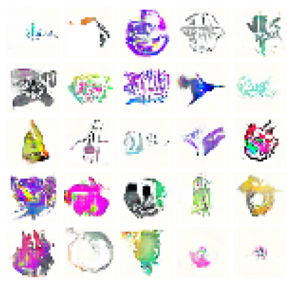

Saving GAN to ./logos_checkpoints2, epoch No. 82
Epoch: 83, Iter: 460, D: 0.08786266297101974, G:0.3578786849975586


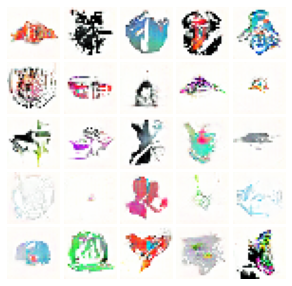

Saving GAN to ./logos_checkpoints2, epoch No. 83
Epoch: 84, Iter: 460, D: 0.09686265885829926, G:0.5152295827865601


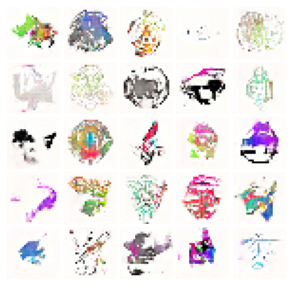

Saving GAN to ./logos_checkpoints2, epoch No. 84
Epoch: 85, Iter: 460, D: 0.06918109953403473, G:0.37458595633506775


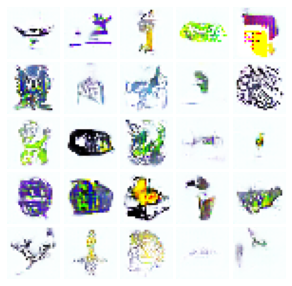

Saving GAN to ./logos_checkpoints2, epoch No. 85
Epoch: 86, Iter: 460, D: 0.10635178536176682, G:0.28250959515571594


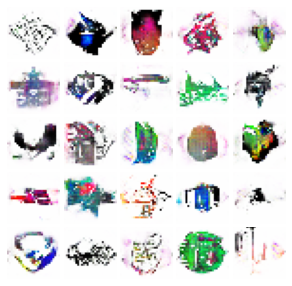

Saving GAN to ./logos_checkpoints2, epoch No. 86
Epoch: 87, Iter: 460, D: 0.06244940310716629, G:0.3766511082649231


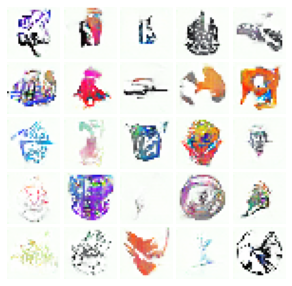

Saving GAN to ./logos_checkpoints2, epoch No. 87
Epoch: 88, Iter: 460, D: 0.06811527162790298, G:0.3769600987434387


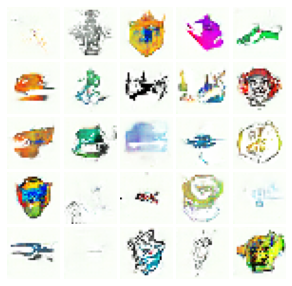

Saving GAN to ./logos_checkpoints2, epoch No. 88
Epoch: 89, Iter: 460, D: 0.09415147453546524, G:0.40443000197410583


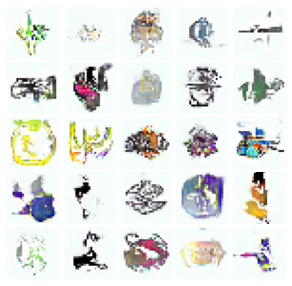

Saving GAN to ./logos_checkpoints2, epoch No. 89
Epoch: 90, Iter: 460, D: 0.08554917573928833, G:0.3717482388019562


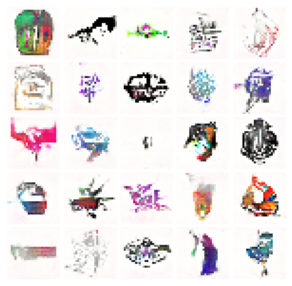

Saving GAN to ./logos_checkpoints2, epoch No. 90
Epoch: 91, Iter: 460, D: 0.06890124082565308, G:0.4114210605621338


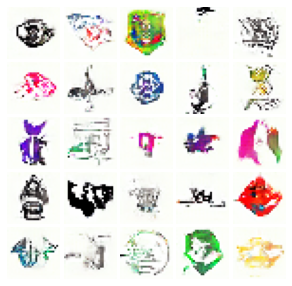

Saving GAN to ./logos_checkpoints2, epoch No. 91
Epoch: 92, Iter: 460, D: 0.08139918744564056, G:0.3229150176048279


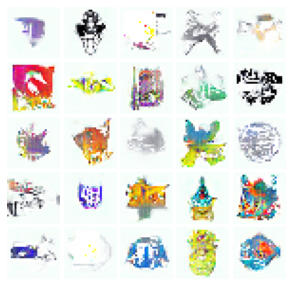

Saving GAN to ./logos_checkpoints2, epoch No. 92
Epoch: 93, Iter: 460, D: 0.07627294957637787, G:0.35409167408943176


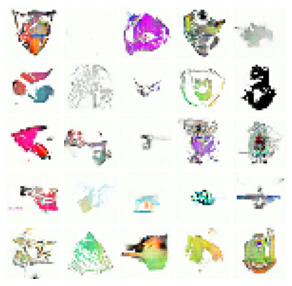

Saving GAN to ./logos_checkpoints2, epoch No. 93
Epoch: 94, Iter: 460, D: 0.08413074910640717, G:0.34878841042518616


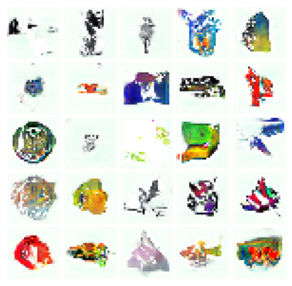

Saving GAN to ./logos_checkpoints2, epoch No. 94
Epoch: 95, Iter: 460, D: 0.07663365453481674, G:0.3662072420120239


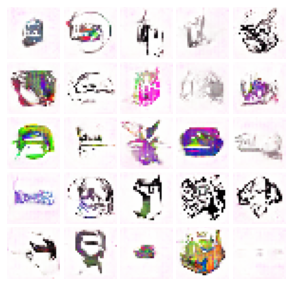

Saving GAN to ./logos_checkpoints2, epoch No. 95
Epoch: 96, Iter: 460, D: 0.08266937732696533, G:0.388906866312027


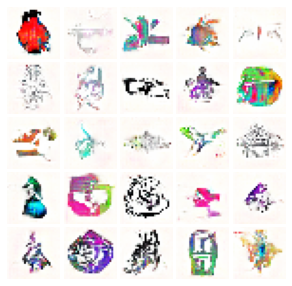

Saving GAN to ./logos_checkpoints2, epoch No. 96
Epoch: 97, Iter: 460, D: 0.0813639834523201, G:0.3162393569946289


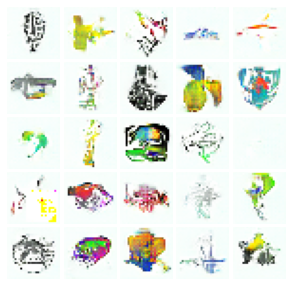

Saving GAN to ./logos_checkpoints2, epoch No. 97
Epoch: 98, Iter: 460, D: 0.1070815771818161, G:0.30360472202301025


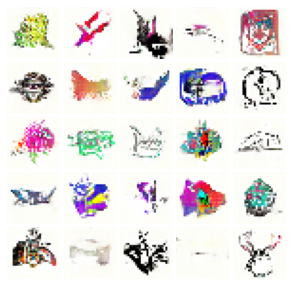

Saving GAN to ./logos_checkpoints2, epoch No. 98
Epoch: 99, Iter: 460, D: 0.10485030710697174, G:0.4201529026031494


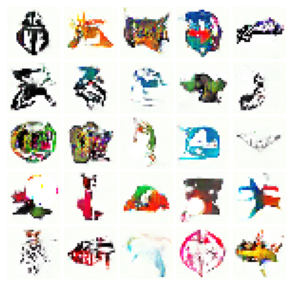

Saving GAN to ./logos_checkpoints2, epoch No. 99
Epoch: 100, Iter: 460, D: 0.07644045352935791, G:0.3314725160598755


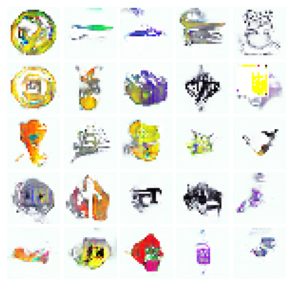

Saving GAN to ./logos_checkpoints2, epoch No. 100
Epoch: 101, Iter: 460, D: 0.08398960530757904, G:0.3139253258705139


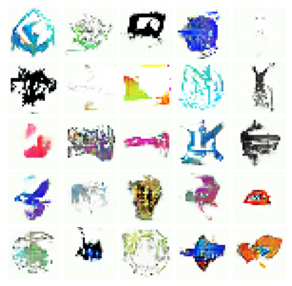

Saving GAN to ./logos_checkpoints2, epoch No. 101
Epoch: 102, Iter: 460, D: 0.08970074355602264, G:0.32946640253067017


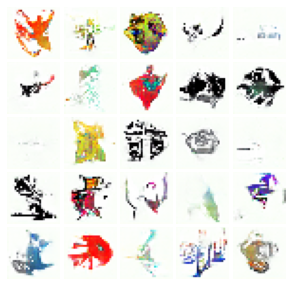

Saving GAN to ./logos_checkpoints2, epoch No. 102
Epoch: 103, Iter: 460, D: 0.07682791352272034, G:0.3728473484516144


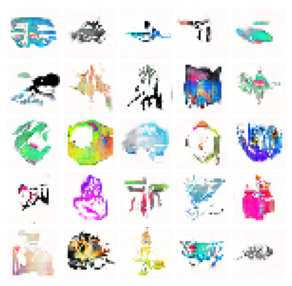

Saving GAN to ./logos_checkpoints2, epoch No. 103
Epoch: 104, Iter: 460, D: 0.06820178031921387, G:0.37664175033569336


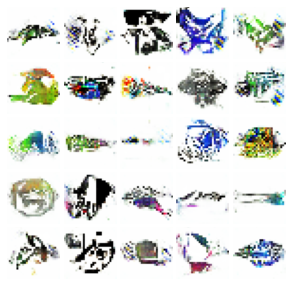

Saving GAN to ./logos_checkpoints2, epoch No. 104
Epoch: 105, Iter: 460, D: 0.08110445737838745, G:0.4053040146827698


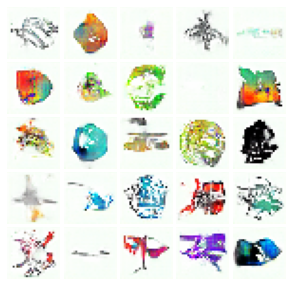

Saving GAN to ./logos_checkpoints2, epoch No. 105
Epoch: 106, Iter: 460, D: 0.08824234455823898, G:0.4376192092895508


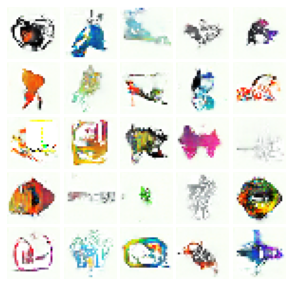

Saving GAN to ./logos_checkpoints2, epoch No. 106
Epoch: 107, Iter: 460, D: 0.07325135171413422, G:0.3537159264087677


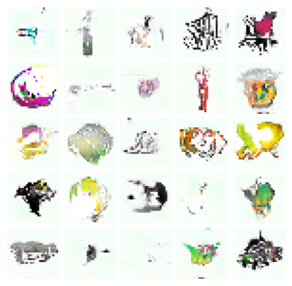

Saving GAN to ./logos_checkpoints2, epoch No. 107
Epoch: 108, Iter: 460, D: 0.08131518959999084, G:0.3420303463935852


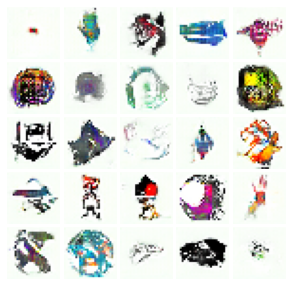

Saving GAN to ./logos_checkpoints2, epoch No. 108
Epoch: 109, Iter: 460, D: 0.08809180557727814, G:0.3077848553657532


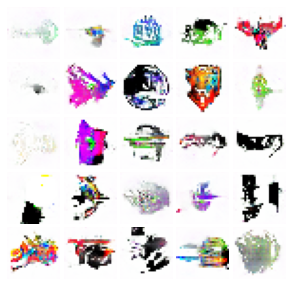

Saving GAN to ./logos_checkpoints2, epoch No. 109
Epoch: 110, Iter: 460, D: 0.07877671718597412, G:0.3866052031517029


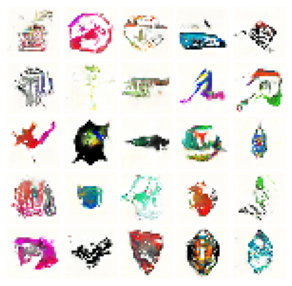

Saving GAN to ./logos_checkpoints2, epoch No. 110
Epoch: 111, Iter: 460, D: 0.0761680155992508, G:0.39813148975372314


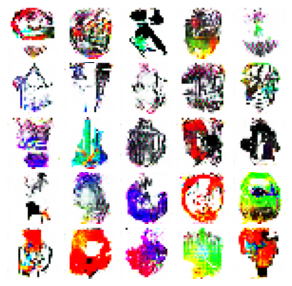

Saving GAN to ./logos_checkpoints2, epoch No. 111
Epoch: 112, Iter: 460, D: 0.08432330936193466, G:0.34729695320129395


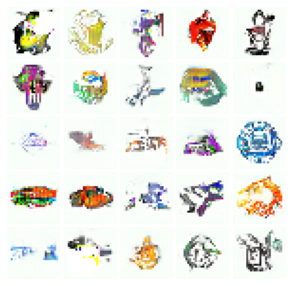

Saving GAN to ./logos_checkpoints2, epoch No. 112
Epoch: 113, Iter: 460, D: 0.06616365909576416, G:0.3661805987358093


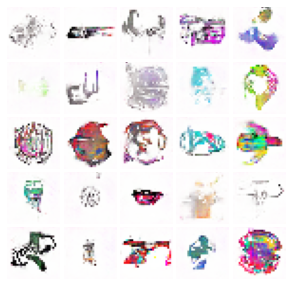

Saving GAN to ./logos_checkpoints2, epoch No. 113
Epoch: 114, Iter: 460, D: 0.07444937527179718, G:0.36202937364578247


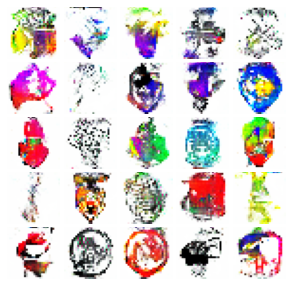

Saving GAN to ./logos_checkpoints2, epoch No. 114
Epoch: 115, Iter: 460, D: 0.0695568323135376, G:0.4872753322124481


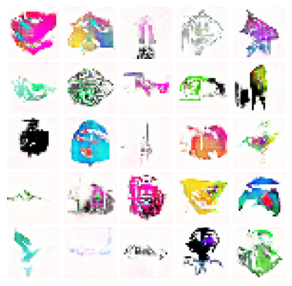

Saving GAN to ./logos_checkpoints2, epoch No. 115
Epoch: 116, Iter: 460, D: 0.08435709774494171, G:0.38556981086730957


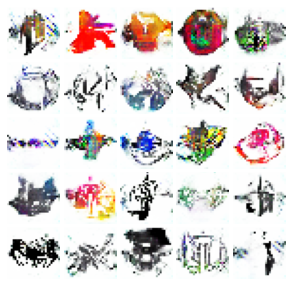

Saving GAN to ./logos_checkpoints2, epoch No. 116
Epoch: 117, Iter: 460, D: 0.0793381854891777, G:0.33560049533843994


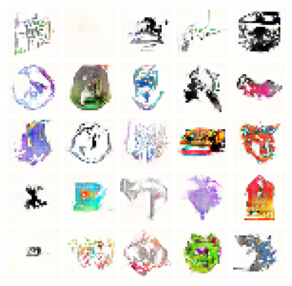

Saving GAN to ./logos_checkpoints2, epoch No. 117
Epoch: 118, Iter: 460, D: 0.08752624690532684, G:0.28439804911613464


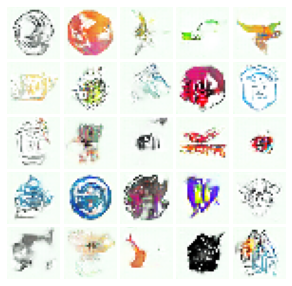

Saving GAN to ./logos_checkpoints2, epoch No. 118
Epoch: 119, Iter: 460, D: 0.07174977660179138, G:0.3915172815322876


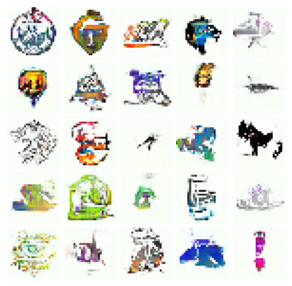

Saving GAN to ./logos_checkpoints2, epoch No. 119
Epoch: 120, Iter: 460, D: 0.07720385491847992, G:0.4062460660934448


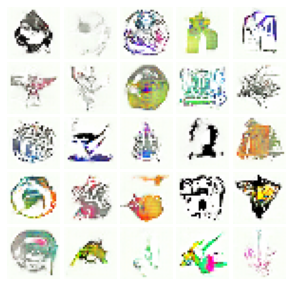

Saving GAN to ./logos_checkpoints2, epoch No. 120
Epoch: 121, Iter: 460, D: 0.10746872425079346, G:0.35459965467453003


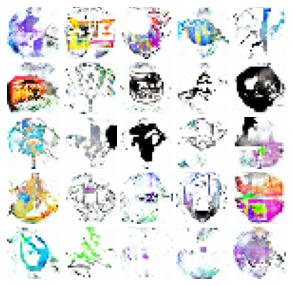

Saving GAN to ./logos_checkpoints2, epoch No. 121
Epoch: 122, Iter: 460, D: 0.09008265286684036, G:0.40597209334373474


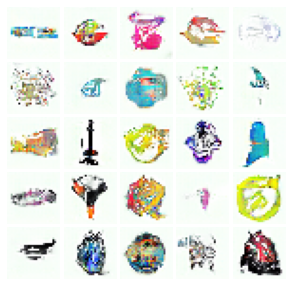

Saving GAN to ./logos_checkpoints2, epoch No. 122
Epoch: 123, Iter: 460, D: 0.09962925314903259, G:0.2757820785045624


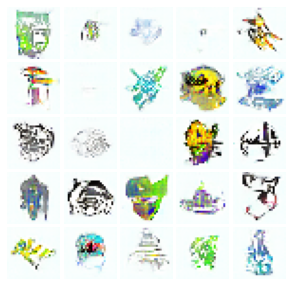

Saving GAN to ./logos_checkpoints2, epoch No. 123
Epoch: 124, Iter: 460, D: 0.07469160109758377, G:0.3901081085205078


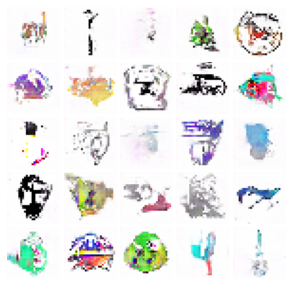

Saving GAN to ./logos_checkpoints2, epoch No. 124
Epoch: 125, Iter: 460, D: 0.07318456470966339, G:0.4460982382297516


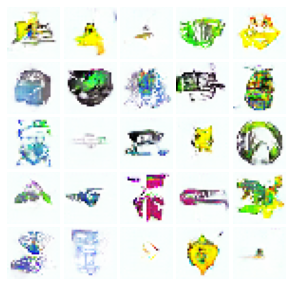

Saving GAN to ./logos_checkpoints2, epoch No. 125
Epoch: 126, Iter: 460, D: 0.09763245284557343, G:0.3179221749305725


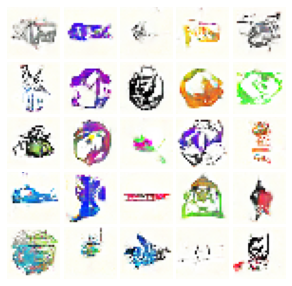

Saving GAN to ./logos_checkpoints2, epoch No. 126
Epoch: 127, Iter: 460, D: 0.06997700780630112, G:0.38456469774246216


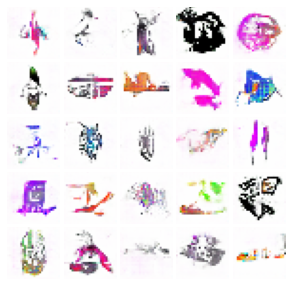

Saving GAN to ./logos_checkpoints2, epoch No. 127
Epoch: 128, Iter: 460, D: 0.09059138596057892, G:0.28954973816871643


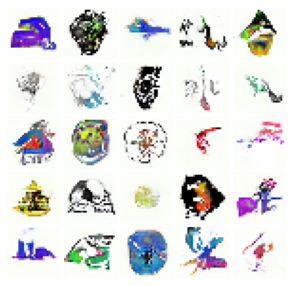

Saving GAN to ./logos_checkpoints2, epoch No. 128
Epoch: 129, Iter: 460, D: 0.08306199312210083, G:0.31331881880760193


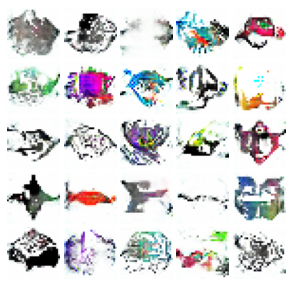

Saving GAN to ./logos_checkpoints2, epoch No. 129
Epoch: 130, Iter: 460, D: 0.08172638714313507, G:0.3395039141178131


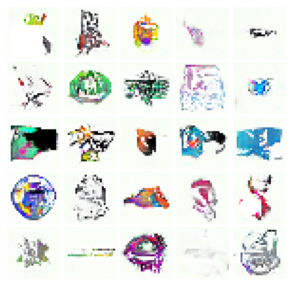

Saving GAN to ./logos_checkpoints2, epoch No. 130
Epoch: 131, Iter: 460, D: 0.10131374001502991, G:0.3449241518974304


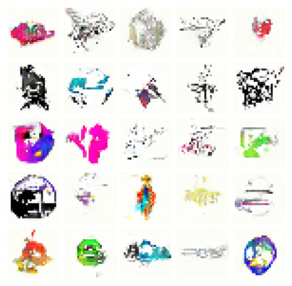

Saving GAN to ./logos_checkpoints2, epoch No. 131
Epoch: 132, Iter: 460, D: 0.08449102938175201, G:0.3400539755821228


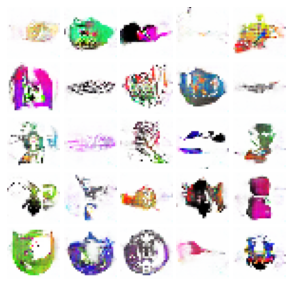

Saving GAN to ./logos_checkpoints2, epoch No. 132
Epoch: 133, Iter: 460, D: 0.07974085211753845, G:0.34857386350631714


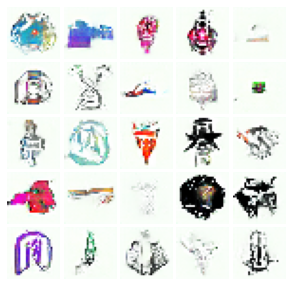

Saving GAN to ./logos_checkpoints2, epoch No. 133
Epoch: 134, Iter: 460, D: 0.08258435130119324, G:0.4109405279159546


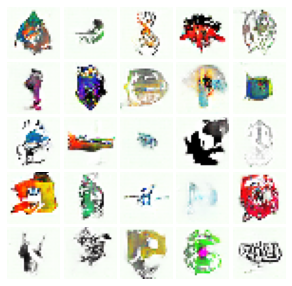

Saving GAN to ./logos_checkpoints2, epoch No. 134
Epoch: 135, Iter: 460, D: 0.06835512071847916, G:0.3837316036224365


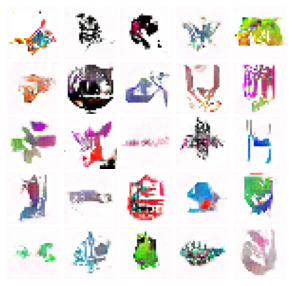

Saving GAN to ./logos_checkpoints2, epoch No. 135
Epoch: 136, Iter: 460, D: 0.07493431121110916, G:0.4000083804130554


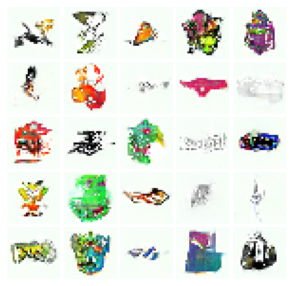

Saving GAN to ./logos_checkpoints2, epoch No. 136
Epoch: 137, Iter: 460, D: 0.0956609845161438, G:0.3733453154563904


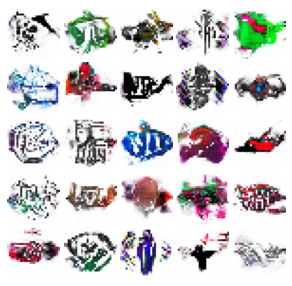

Saving GAN to ./logos_checkpoints2, epoch No. 137
Epoch: 138, Iter: 460, D: 0.08414118736982346, G:0.3659237027168274


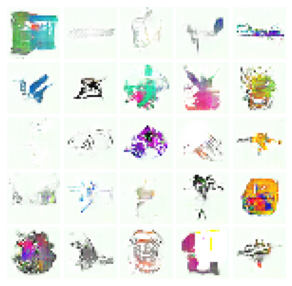

Saving GAN to ./logos_checkpoints2, epoch No. 138
Epoch: 139, Iter: 460, D: 0.08249764889478683, G:0.4246296286582947


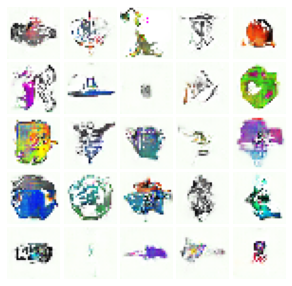

Saving GAN to ./logos_checkpoints2, epoch No. 139
Epoch: 140, Iter: 460, D: 0.08188441395759583, G:0.3190051317214966


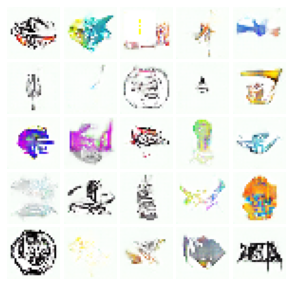

Saving GAN to ./logos_checkpoints2, epoch No. 140
Epoch: 141, Iter: 460, D: 0.10344839841127396, G:0.35811465978622437


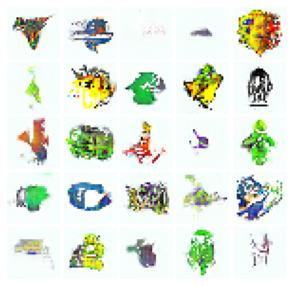

Saving GAN to ./logos_checkpoints2, epoch No. 141
Epoch: 142, Iter: 460, D: 0.06754890829324722, G:0.393231600522995


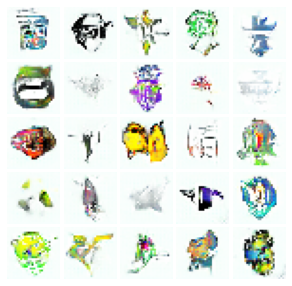

Saving GAN to ./logos_checkpoints2, epoch No. 142
Epoch: 143, Iter: 460, D: 0.10792409628629684, G:0.3521256446838379


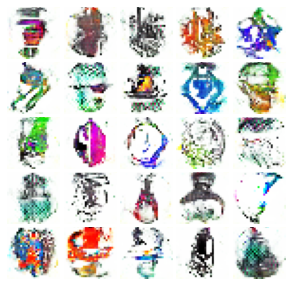

Saving GAN to ./logos_checkpoints2, epoch No. 143
Epoch: 144, Iter: 460, D: 0.09251466393470764, G:0.3217209279537201


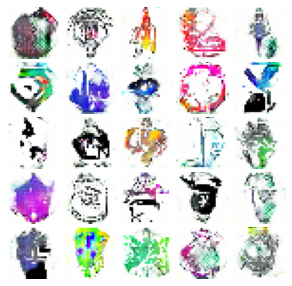

Saving GAN to ./logos_checkpoints2, epoch No. 144
Epoch: 145, Iter: 460, D: 0.08323442190885544, G:0.4120905101299286


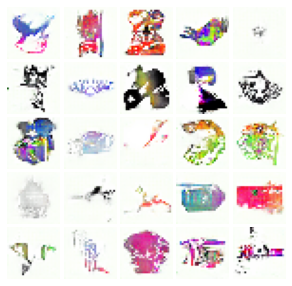

Saving GAN to ./logos_checkpoints2, epoch No. 145
Epoch: 146, Iter: 460, D: 0.09015125036239624, G:0.3214159607887268


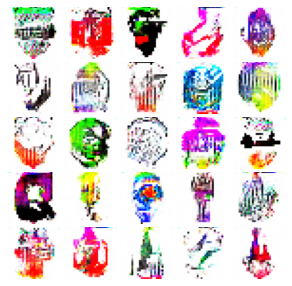

Saving GAN to ./logos_checkpoints2, epoch No. 146
Epoch: 147, Iter: 460, D: 0.07438207417726517, G:0.3452494144439697


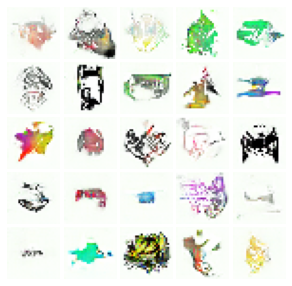

Saving GAN to ./logos_checkpoints2, epoch No. 147
Epoch: 148, Iter: 460, D: 0.0986059308052063, G:0.5216487646102905


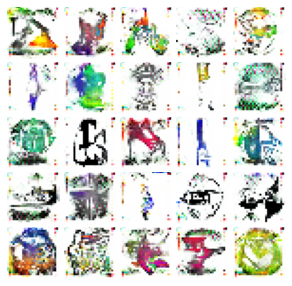

Saving GAN to ./logos_checkpoints2, epoch No. 148
Epoch: 149, Iter: 460, D: 0.07666532695293427, G:0.4135431945323944


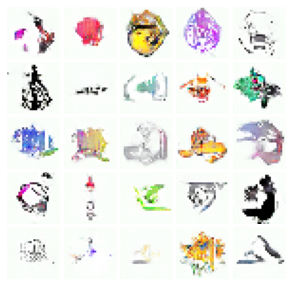

Saving GAN to ./logos_checkpoints2, epoch No. 149
Epoch: 150, Iter: 460, D: 0.09860894829034805, G:0.29443874955177307


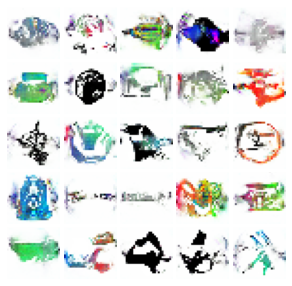

Saving GAN to ./logos_checkpoints2, epoch No. 150
Epoch: 151, Iter: 460, D: 0.08483439683914185, G:0.4352979063987732


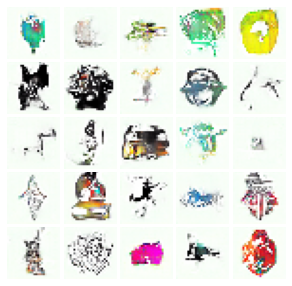

Saving GAN to ./logos_checkpoints2, epoch No. 151
Epoch: 152, Iter: 460, D: 0.08116314560174942, G:0.3343808054924011


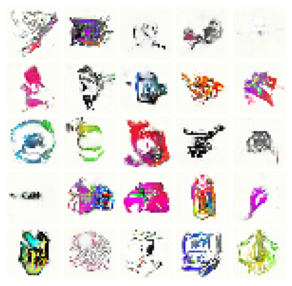

Saving GAN to ./logos_checkpoints2, epoch No. 152
Epoch: 153, Iter: 460, D: 0.07767663151025772, G:0.4228779077529907


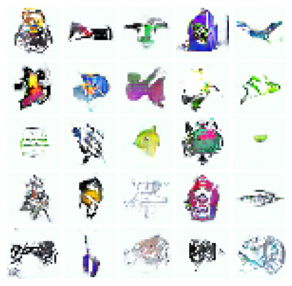

Saving GAN to ./logos_checkpoints2, epoch No. 153
Epoch: 154, Iter: 460, D: 0.13688212633132935, G:0.2546955943107605


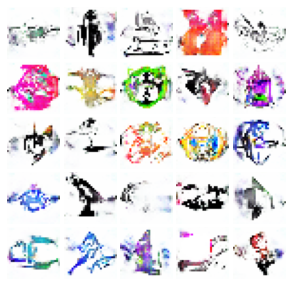

Saving GAN to ./logos_checkpoints2, epoch No. 154
Epoch: 155, Iter: 460, D: 0.07346770912408829, G:0.40563786029815674


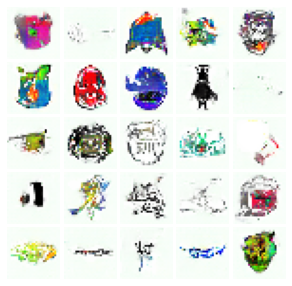

Saving GAN to ./logos_checkpoints2, epoch No. 155
Epoch: 156, Iter: 460, D: 0.06201303005218506, G:0.41938281059265137


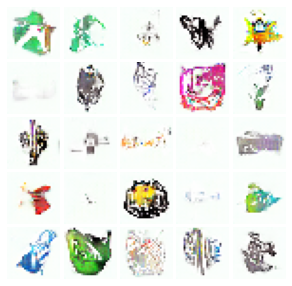

Saving GAN to ./logos_checkpoints2, epoch No. 156
Epoch: 157, Iter: 460, D: 0.07534411549568176, G:0.4622517228126526


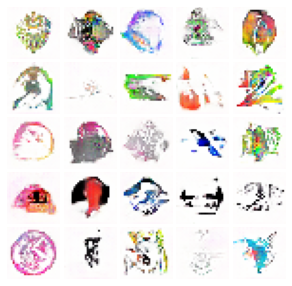

Saving GAN to ./logos_checkpoints2, epoch No. 157
Epoch: 158, Iter: 460, D: 0.07452835142612457, G:0.4269478917121887


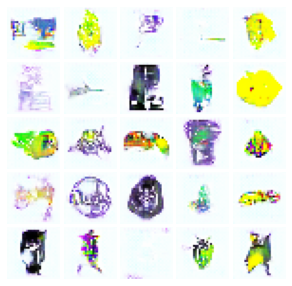

Saving GAN to ./logos_checkpoints2, epoch No. 158
Epoch: 159, Iter: 460, D: 0.09368207305669785, G:0.28659874200820923


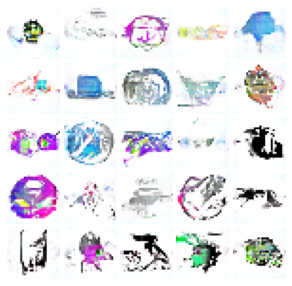

Saving GAN to ./logos_checkpoints2, epoch No. 159
Epoch: 160, Iter: 460, D: 0.06771878153085709, G:0.4366723895072937


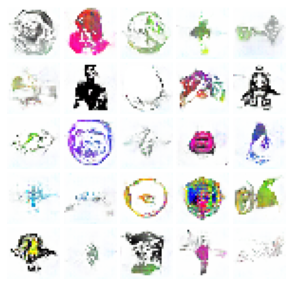

Saving GAN to ./logos_checkpoints2, epoch No. 160
Epoch: 161, Iter: 460, D: 0.07420194894075394, G:0.37359344959259033


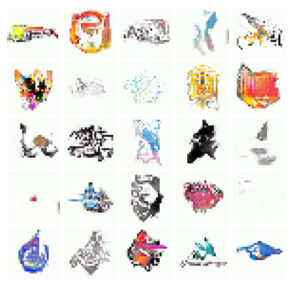

Saving GAN to ./logos_checkpoints2, epoch No. 161
Epoch: 162, Iter: 460, D: 0.10308119654655457, G:0.26661890745162964


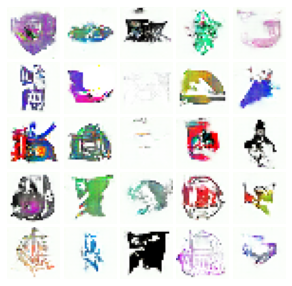

Saving GAN to ./logos_checkpoints2, epoch No. 162
Epoch: 163, Iter: 460, D: 0.09381964057683945, G:0.3693429231643677


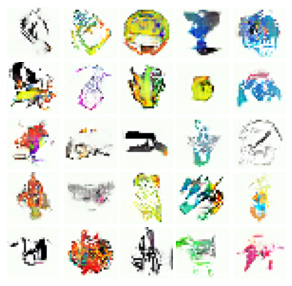

Saving GAN to ./logos_checkpoints2, epoch No. 163
Epoch: 164, Iter: 460, D: 0.09342287480831146, G:0.35356807708740234


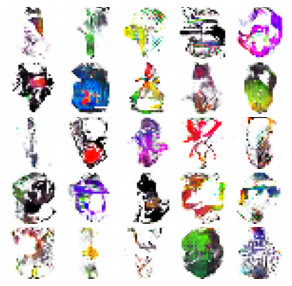

Saving GAN to ./logos_checkpoints2, epoch No. 164
Epoch: 165, Iter: 460, D: 0.07232023030519485, G:0.44482362270355225


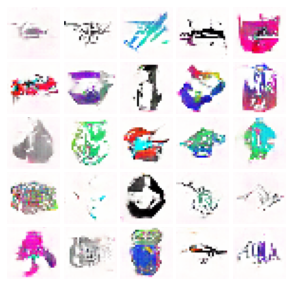

Saving GAN to ./logos_checkpoints2, epoch No. 165
Epoch: 166, Iter: 460, D: 0.07647712528705597, G:0.3510809540748596


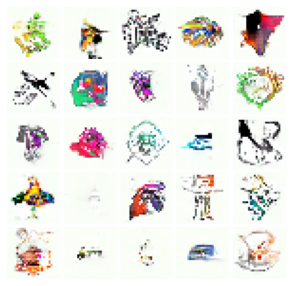

Saving GAN to ./logos_checkpoints2, epoch No. 166
Epoch: 167, Iter: 460, D: 0.07434003800153732, G:0.39333537220954895


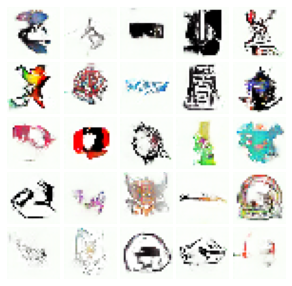

Saving GAN to ./logos_checkpoints2, epoch No. 167
Epoch: 168, Iter: 460, D: 0.07307356595993042, G:0.45593929290771484


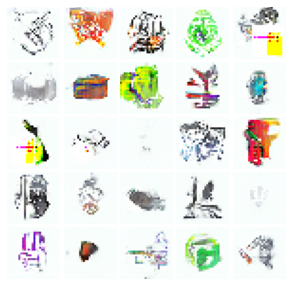

Saving GAN to ./logos_checkpoints2, epoch No. 168
Epoch: 169, Iter: 460, D: 0.07685133814811707, G:0.37663036584854126


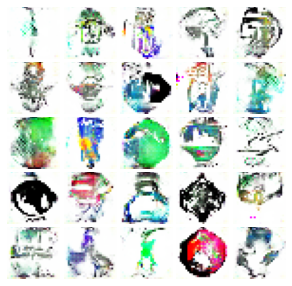

Saving GAN to ./logos_checkpoints2, epoch No. 169
Epoch: 170, Iter: 460, D: 0.08659157156944275, G:0.42761266231536865


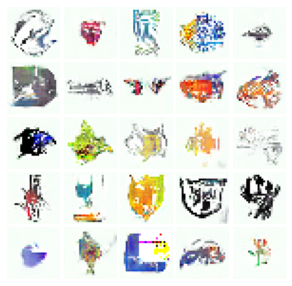

Saving GAN to ./logos_checkpoints2, epoch No. 170
Epoch: 171, Iter: 460, D: 0.07912066578865051, G:0.3660336136817932


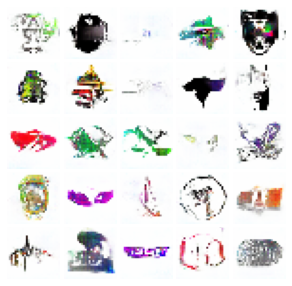

Saving GAN to ./logos_checkpoints2, epoch No. 171
Epoch: 172, Iter: 460, D: 0.07622238248586655, G:0.319338321685791


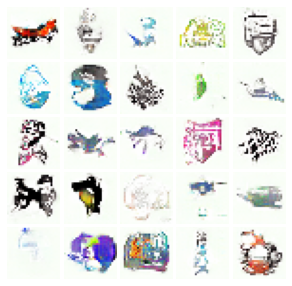

Saving GAN to ./logos_checkpoints2, epoch No. 172
Epoch: 173, Iter: 460, D: 0.11584613472223282, G:0.24452565610408783


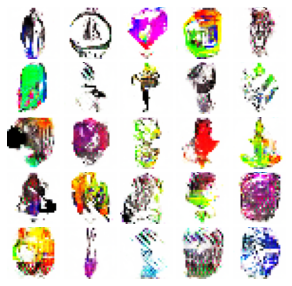

Saving GAN to ./logos_checkpoints2, epoch No. 173
Epoch: 174, Iter: 460, D: 0.09071971476078033, G:0.3787282705307007


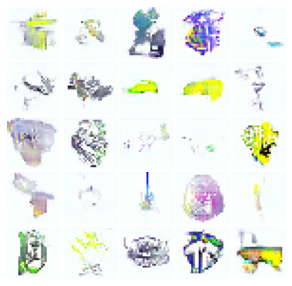

Saving GAN to ./logos_checkpoints2, epoch No. 174
Epoch: 175, Iter: 460, D: 0.08456891775131226, G:0.3694794774055481


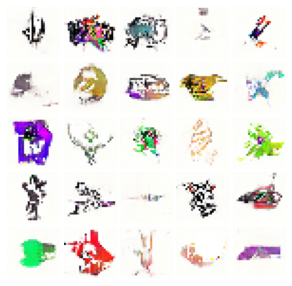

Saving GAN to ./logos_checkpoints2, epoch No. 175
Epoch: 176, Iter: 460, D: 0.07705062627792358, G:0.3613350987434387


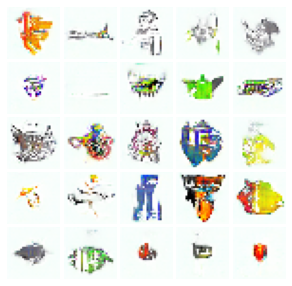

Saving GAN to ./logos_checkpoints2, epoch No. 176
Epoch: 177, Iter: 460, D: 0.10352549701929092, G:0.42090877890586853


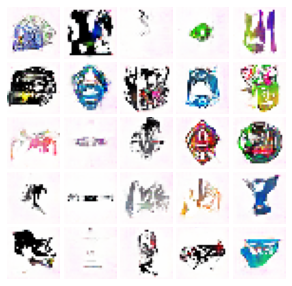

Saving GAN to ./logos_checkpoints2, epoch No. 177
Epoch: 178, Iter: 460, D: 0.08107890188694, G:0.3931960165500641


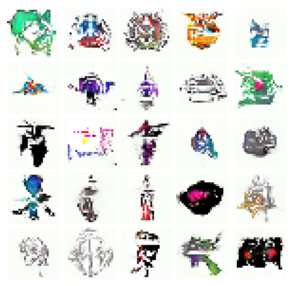

Saving GAN to ./logos_checkpoints2, epoch No. 178
Epoch: 179, Iter: 460, D: 0.07283233106136322, G:0.37081363797187805


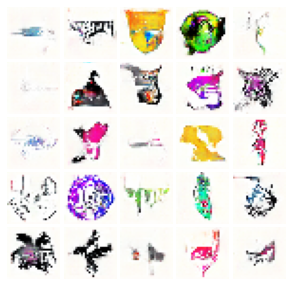

Saving GAN to ./logos_checkpoints2, epoch No. 179
Epoch: 180, Iter: 460, D: 0.07137364149093628, G:0.45604878664016724


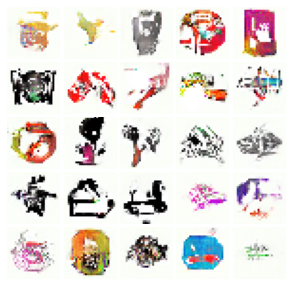

Saving GAN to ./logos_checkpoints2, epoch No. 180
Epoch: 181, Iter: 460, D: 0.06936439871788025, G:0.4254843592643738


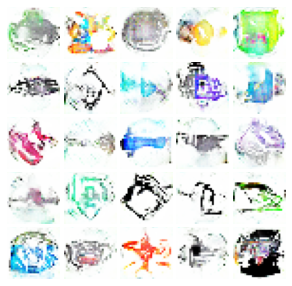

Saving GAN to ./logos_checkpoints2, epoch No. 181
Epoch: 182, Iter: 460, D: 0.0776764526963234, G:0.3988839089870453


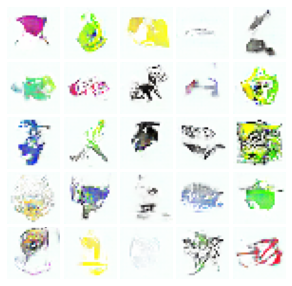

Saving GAN to ./logos_checkpoints2, epoch No. 182
Epoch: 183, Iter: 460, D: 0.06315778195858002, G:0.4034244418144226


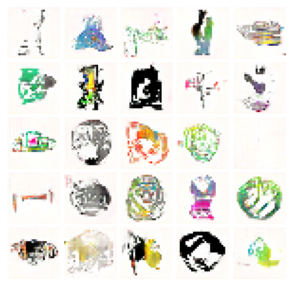

Saving GAN to ./logos_checkpoints2, epoch No. 183
Epoch: 184, Iter: 460, D: 0.08020495623350143, G:0.34822165966033936


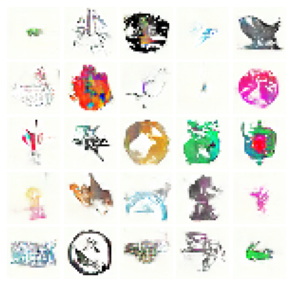

Saving GAN to ./logos_checkpoints2, epoch No. 184
Epoch: 185, Iter: 460, D: 0.08865009993314743, G:0.3865411877632141


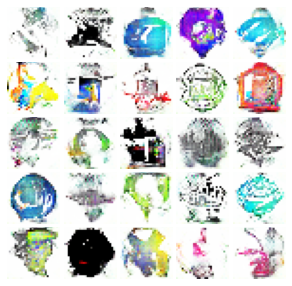

Saving GAN to ./logos_checkpoints2, epoch No. 185
Epoch: 186, Iter: 460, D: 0.07933679968118668, G:0.4055206775665283


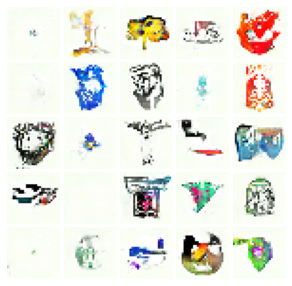

Saving GAN to ./logos_checkpoints2, epoch No. 186
Epoch: 187, Iter: 460, D: 0.09003984928131104, G:0.379285991191864


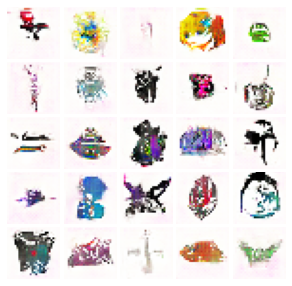

Saving GAN to ./logos_checkpoints2, epoch No. 187
Epoch: 188, Iter: 460, D: 0.08782322704792023, G:0.4148368835449219


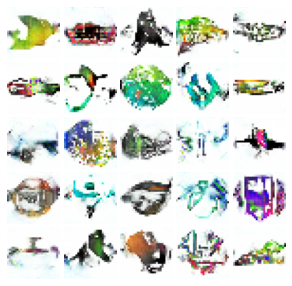

Saving GAN to ./logos_checkpoints2, epoch No. 188
Epoch: 189, Iter: 460, D: 0.07722179591655731, G:0.39136070013046265


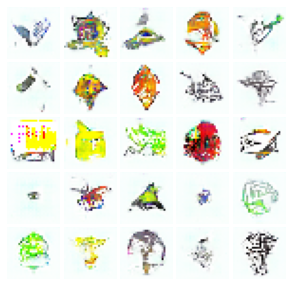

Saving GAN to ./logos_checkpoints2, epoch No. 189
Epoch: 190, Iter: 460, D: 0.06616957485675812, G:0.36980190873146057


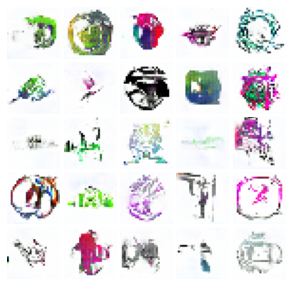

Saving GAN to ./logos_checkpoints2, epoch No. 190
Epoch: 191, Iter: 460, D: 0.07352955639362335, G:0.44414135813713074


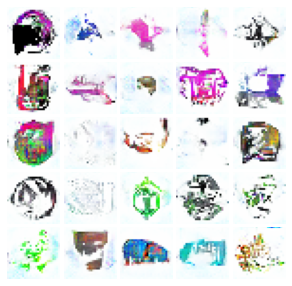

Saving GAN to ./logos_checkpoints2, epoch No. 191
Epoch: 192, Iter: 460, D: 0.09749206900596619, G:0.3073480725288391


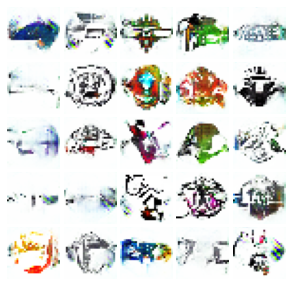

Saving GAN to ./logos_checkpoints2, epoch No. 192
Epoch: 193, Iter: 460, D: 0.09103065729141235, G:0.3949640393257141


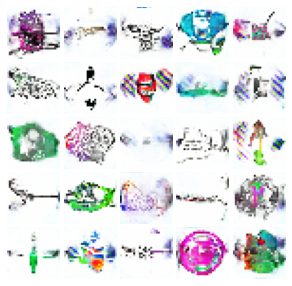

Saving GAN to ./logos_checkpoints2, epoch No. 193
Epoch: 194, Iter: 460, D: 0.08254233002662659, G:0.4094257056713104


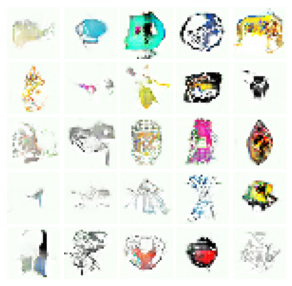

Saving GAN to ./logos_checkpoints2, epoch No. 194
Epoch: 195, Iter: 460, D: 0.08637583255767822, G:0.43700313568115234


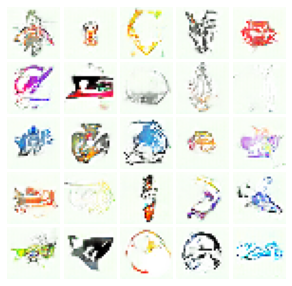

Saving GAN to ./logos_checkpoints2, epoch No. 195
Epoch: 196, Iter: 460, D: 0.075119748711586, G:0.379395067691803


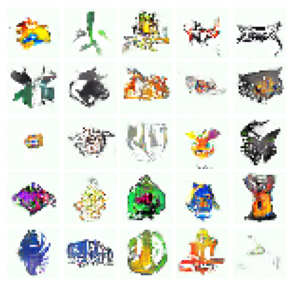

Saving GAN to ./logos_checkpoints2, epoch No. 196
Epoch: 197, Iter: 460, D: 0.08542618900537491, G:0.37659120559692383


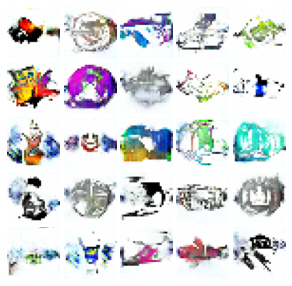

Saving GAN to ./logos_checkpoints2, epoch No. 197
Epoch: 198, Iter: 460, D: 0.07412289083003998, G:0.3838363289833069


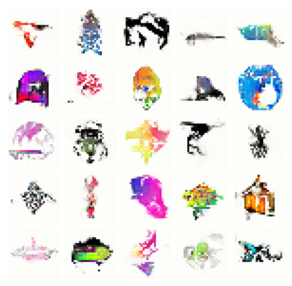

Saving GAN to ./logos_checkpoints2, epoch No. 198
Epoch: 199, Iter: 460, D: 0.0806826502084732, G:0.3314288556575775


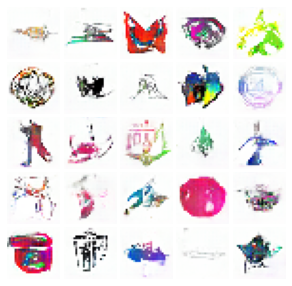

Saving GAN to ./logos_checkpoints2, epoch No. 199
Epoch: 200, Iter: 460, D: 0.07243584096431732, G:0.378000408411026


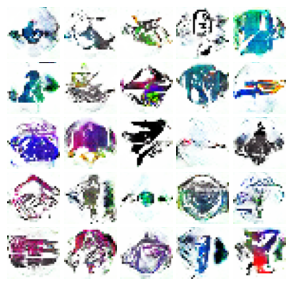

Saving GAN to ./logos_checkpoints2, epoch No. 200
Epoch: 201, Iter: 460, D: 0.09809078276157379, G:0.3581233024597168


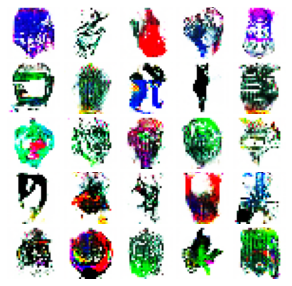

Saving GAN to ./logos_checkpoints2, epoch No. 201
Epoch: 202, Iter: 460, D: 0.09126123785972595, G:0.30958789587020874


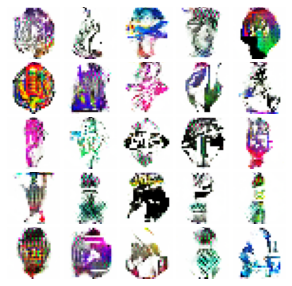

Saving GAN to ./logos_checkpoints2, epoch No. 202
Epoch: 203, Iter: 460, D: 0.07349355518817902, G:0.3954830765724182


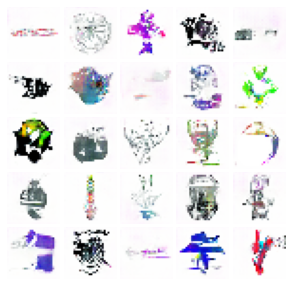

Saving GAN to ./logos_checkpoints2, epoch No. 203
Epoch: 204, Iter: 460, D: 0.08871464431285858, G:0.3463327884674072


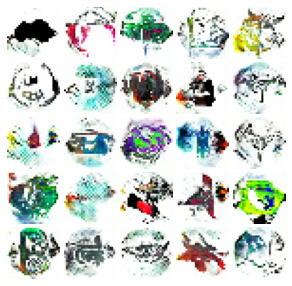

Saving GAN to ./logos_checkpoints2, epoch No. 204
Epoch: 205, Iter: 460, D: 0.09018954634666443, G:0.3220992684364319


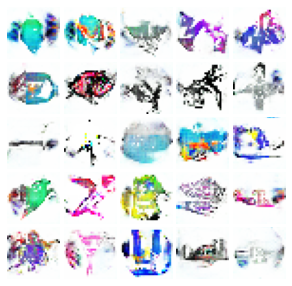

Saving GAN to ./logos_checkpoints2, epoch No. 205
Epoch: 206, Iter: 460, D: 0.09028515219688416, G:0.32384762167930603


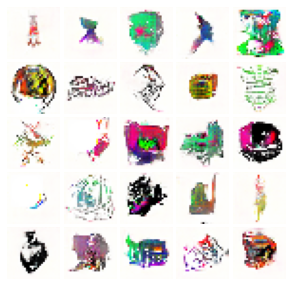

Saving GAN to ./logos_checkpoints2, epoch No. 206
Epoch: 207, Iter: 460, D: 0.06801272928714752, G:0.4130677580833435


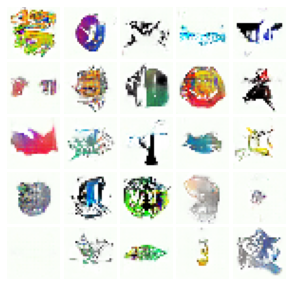

Saving GAN to ./logos_checkpoints2, epoch No. 207
Epoch: 208, Iter: 460, D: 0.0846683457493782, G:0.41556769609451294


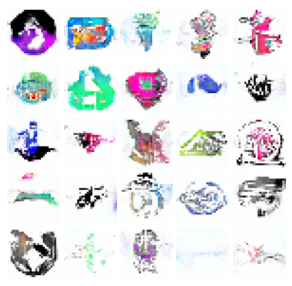

Saving GAN to ./logos_checkpoints2, epoch No. 208
Epoch: 209, Iter: 460, D: 0.07757405936717987, G:0.3905101716518402


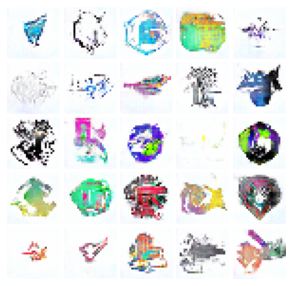

Saving GAN to ./logos_checkpoints2, epoch No. 209
Epoch: 210, Iter: 460, D: 0.09421737492084503, G:0.3156724274158478


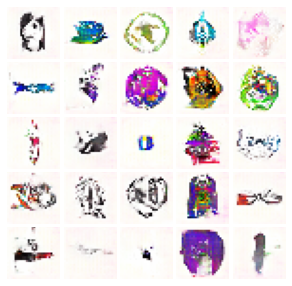

Saving GAN to ./logos_checkpoints2, epoch No. 210
Epoch: 211, Iter: 460, D: 0.07991693913936615, G:0.4112280607223511


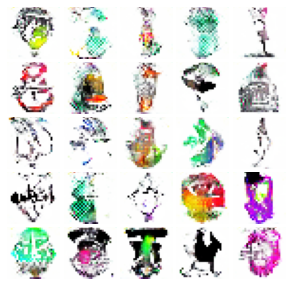

Saving GAN to ./logos_checkpoints2, epoch No. 211
Epoch: 212, Iter: 460, D: 0.08749596774578094, G:0.36011695861816406


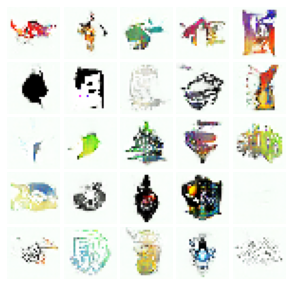

Saving GAN to ./logos_checkpoints2, epoch No. 212
Epoch: 213, Iter: 460, D: 0.08701121807098389, G:0.3458069860935211


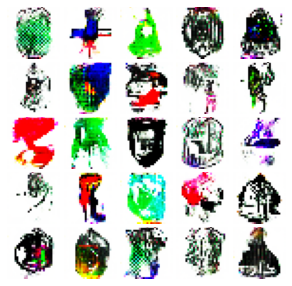

Saving GAN to ./logos_checkpoints2, epoch No. 213
Epoch: 214, Iter: 460, D: 0.08705359697341919, G:0.5045381784439087


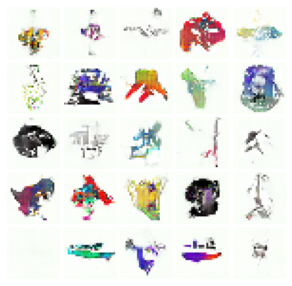

Saving GAN to ./logos_checkpoints2, epoch No. 214
Epoch: 215, Iter: 460, D: 0.09624674916267395, G:0.36247721314430237


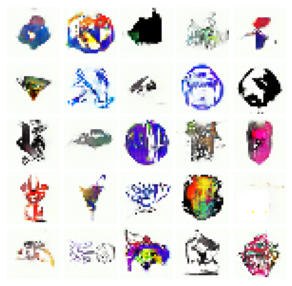

Saving GAN to ./logos_checkpoints2, epoch No. 215
Epoch: 216, Iter: 460, D: 0.079149529337883, G:0.4155764877796173


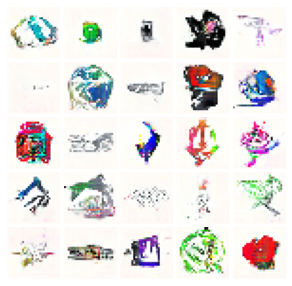

Saving GAN to ./logos_checkpoints2, epoch No. 216
Epoch: 217, Iter: 460, D: 0.09063605964183807, G:0.3211243748664856


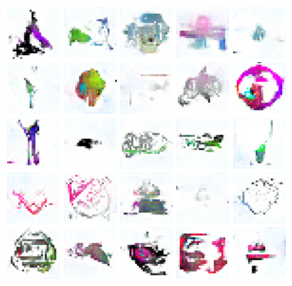

Saving GAN to ./logos_checkpoints2, epoch No. 217
Epoch: 218, Iter: 460, D: 0.07675926387310028, G:0.40651822090148926


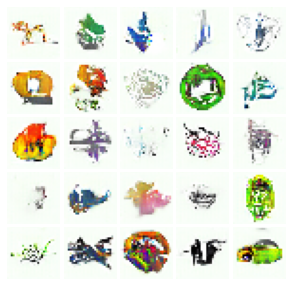

Saving GAN to ./logos_checkpoints2, epoch No. 218
Epoch: 219, Iter: 460, D: 0.09500958025455475, G:0.39342501759529114


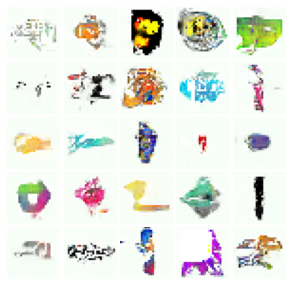

Saving GAN to ./logos_checkpoints2, epoch No. 219
Epoch: 220, Iter: 460, D: 0.08160314708948135, G:0.31325477361679077


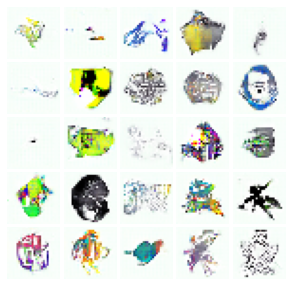

Saving GAN to ./logos_checkpoints2, epoch No. 220
Epoch: 221, Iter: 460, D: 0.07802005112171173, G:0.3992295265197754


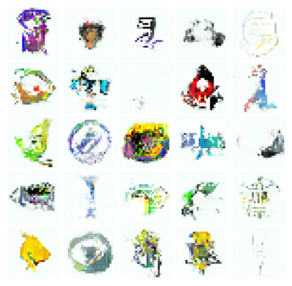

Saving GAN to ./logos_checkpoints2, epoch No. 221
Epoch: 222, Iter: 460, D: 0.07936952263116837, G:0.3967246115207672


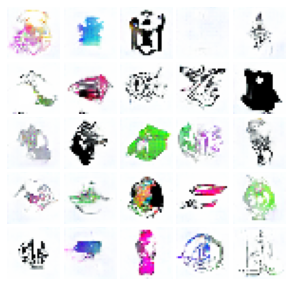

Saving GAN to ./logos_checkpoints2, epoch No. 222
Epoch: 223, Iter: 460, D: 0.08510905504226685, G:0.3288406431674957


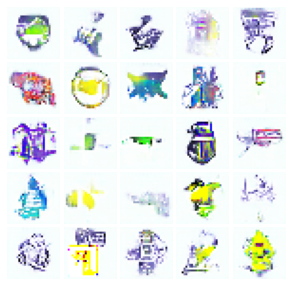

Saving GAN to ./logos_checkpoints2, epoch No. 223
Epoch: 224, Iter: 460, D: 0.10548898577690125, G:0.2817116975784302


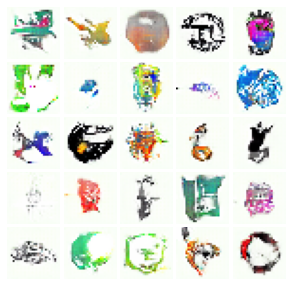

Saving GAN to ./logos_checkpoints2, epoch No. 224
Epoch: 225, Iter: 460, D: 0.0812864899635315, G:0.32445067167282104


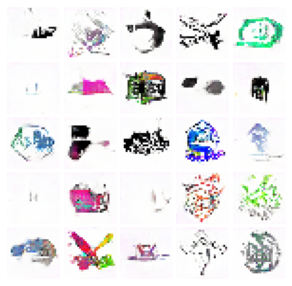

Saving GAN to ./logos_checkpoints2, epoch No. 225
Epoch: 226, Iter: 460, D: 0.07855277508497238, G:0.38912779092788696


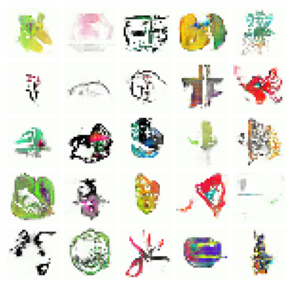

Saving GAN to ./logos_checkpoints2, epoch No. 226
Epoch: 227, Iter: 460, D: 0.0761914923787117, G:0.37636464834213257


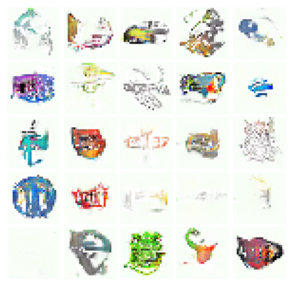

Saving GAN to ./logos_checkpoints2, epoch No. 227
Epoch: 228, Iter: 460, D: 0.08403559029102325, G:0.42540353536605835


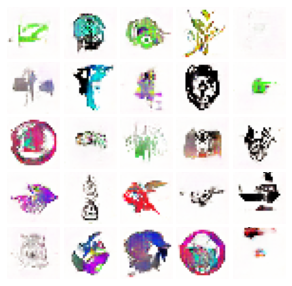

Saving GAN to ./logos_checkpoints2, epoch No. 228
Epoch: 229, Iter: 460, D: 0.08462889492511749, G:0.4223578870296478


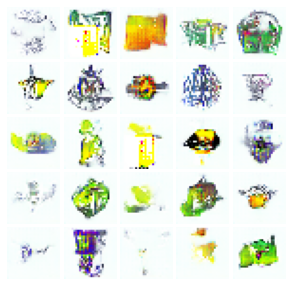

Saving GAN to ./logos_checkpoints2, epoch No. 229
Epoch: 230, Iter: 460, D: 0.08868803083896637, G:0.4609217047691345


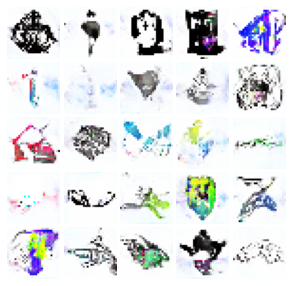

Saving GAN to ./logos_checkpoints2, epoch No. 230
Epoch: 231, Iter: 460, D: 0.06891397386789322, G:0.442965567111969


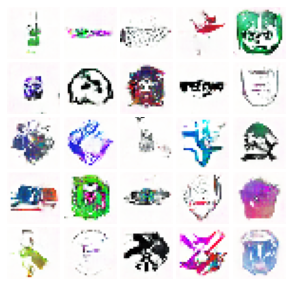

Saving GAN to ./logos_checkpoints2, epoch No. 231
Epoch: 232, Iter: 460, D: 0.08264533430337906, G:0.45270055532455444


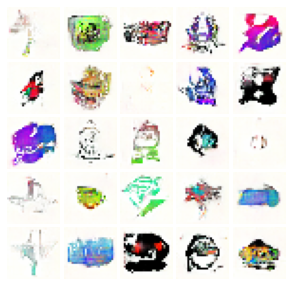

Saving GAN to ./logos_checkpoints2, epoch No. 232
Epoch: 233, Iter: 460, D: 0.10256470739841461, G:0.42329102754592896


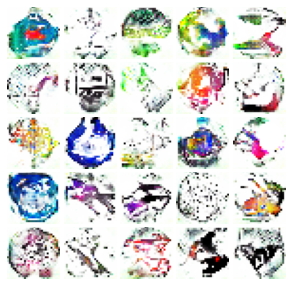

Saving GAN to ./logos_checkpoints2, epoch No. 233
Epoch: 234, Iter: 460, D: 0.08081307262182236, G:0.31732064485549927


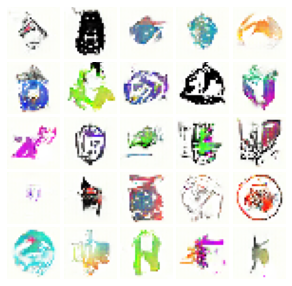

Saving GAN to ./logos_checkpoints2, epoch No. 234
Epoch: 235, Iter: 460, D: 0.09429008513689041, G:0.30444690585136414


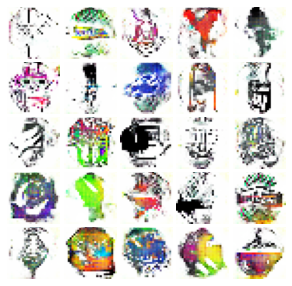

Saving GAN to ./logos_checkpoints2, epoch No. 235
Epoch: 236, Iter: 460, D: 0.08340147137641907, G:0.33362606167793274


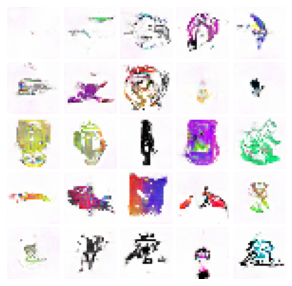

Saving GAN to ./logos_checkpoints2, epoch No. 236
Epoch: 237, Iter: 460, D: 0.07707397639751434, G:0.35539528727531433


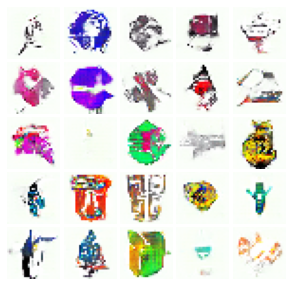

Saving GAN to ./logos_checkpoints2, epoch No. 237
Epoch: 238, Iter: 460, D: 0.07350216805934906, G:0.3679822087287903


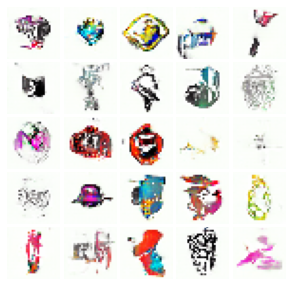

Saving GAN to ./logos_checkpoints2, epoch No. 238
Epoch: 239, Iter: 460, D: 0.08077175915241241, G:0.3571443557739258


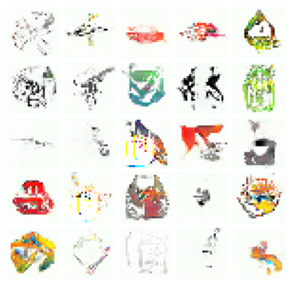

Saving GAN to ./logos_checkpoints2, epoch No. 239
Epoch: 240, Iter: 460, D: 0.07980252802371979, G:0.4414324164390564


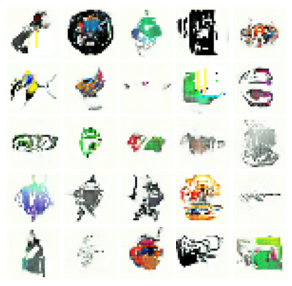

Saving GAN to ./logos_checkpoints2, epoch No. 240
Epoch: 241, Iter: 460, D: 0.07878588140010834, G:0.37614524364471436


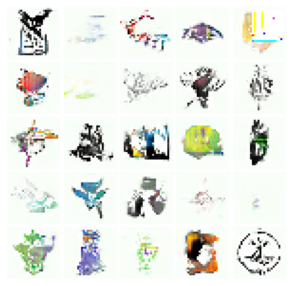

Saving GAN to ./logos_checkpoints2, epoch No. 241
Epoch: 242, Iter: 460, D: 0.09323376417160034, G:0.31690382957458496


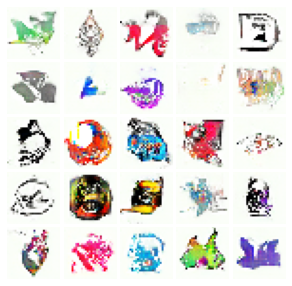

Saving GAN to ./logos_checkpoints2, epoch No. 242
Epoch: 243, Iter: 460, D: 0.07137181609869003, G:0.3802863359451294


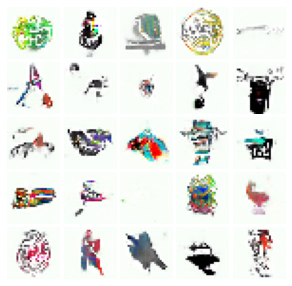

Saving GAN to ./logos_checkpoints2, epoch No. 243
Epoch: 244, Iter: 460, D: 0.09854692965745926, G:0.31668949127197266


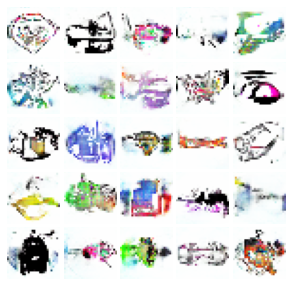

Saving GAN to ./logos_checkpoints2, epoch No. 244
Epoch: 245, Iter: 460, D: 0.06886742264032364, G:0.388801634311676


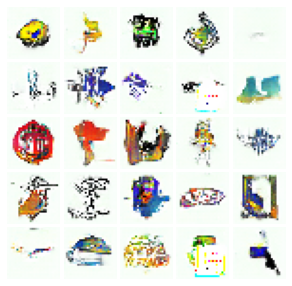

Saving GAN to ./logos_checkpoints2, epoch No. 245
Epoch: 246, Iter: 460, D: 0.0766075998544693, G:0.4263628125190735


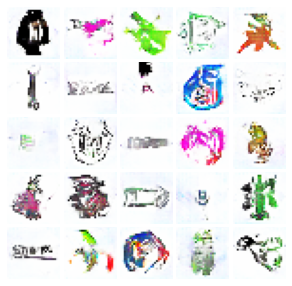

Saving GAN to ./logos_checkpoints2, epoch No. 246
Epoch: 247, Iter: 460, D: 0.08101706206798553, G:0.35104796290397644


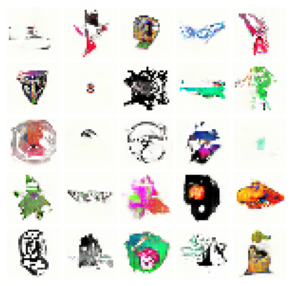

Saving GAN to ./logos_checkpoints2, epoch No. 247
Epoch: 248, Iter: 460, D: 0.09018055349588394, G:0.45769190788269043


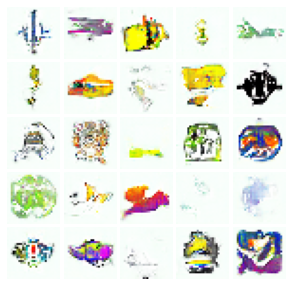

Saving GAN to ./logos_checkpoints2, epoch No. 248
Epoch: 249, Iter: 460, D: 0.09655438363552094, G:0.2721751928329468


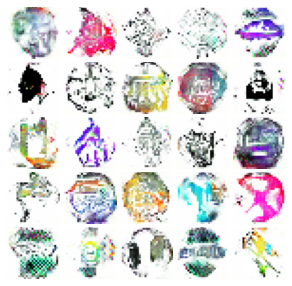

Saving GAN to ./logos_checkpoints2, epoch No. 249
Epoch: 250, Iter: 460, D: 0.06793975830078125, G:0.33761000633239746


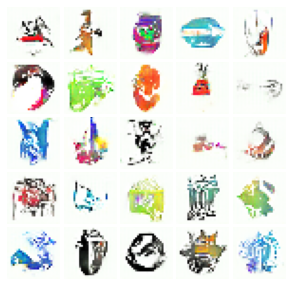

Saving GAN to ./logos_checkpoints2, epoch No. 250
Epoch: 251, Iter: 460, D: 0.08500578254461288, G:0.38618165254592896


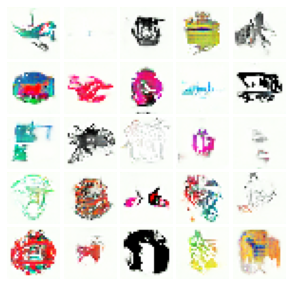

Saving GAN to ./logos_checkpoints2, epoch No. 251
Epoch: 252, Iter: 460, D: 0.06934654712677002, G:0.3762257397174835


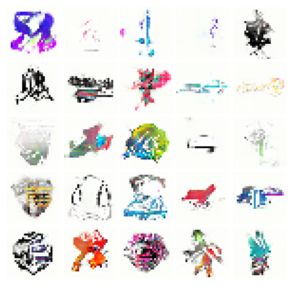

Saving GAN to ./logos_checkpoints2, epoch No. 252
Epoch: 253, Iter: 460, D: 0.0769936740398407, G:0.36433660984039307


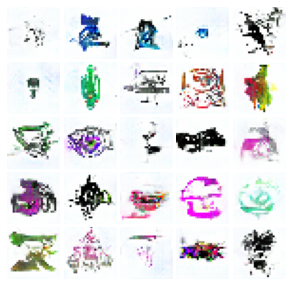

Saving GAN to ./logos_checkpoints2, epoch No. 253
Epoch: 254, Iter: 460, D: 0.09401750564575195, G:0.32423871755599976


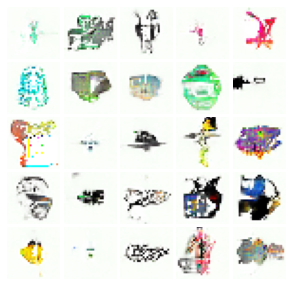

Saving GAN to ./logos_checkpoints2, epoch No. 254
Epoch: 255, Iter: 460, D: 0.08383797109127045, G:0.3025934100151062


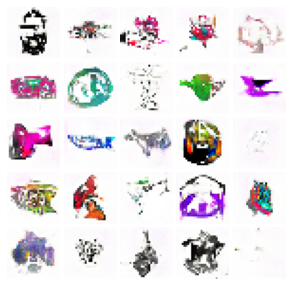

Saving GAN to ./logos_checkpoints2, epoch No. 255
Epoch: 256, Iter: 460, D: 0.10497930645942688, G:0.27601298689842224


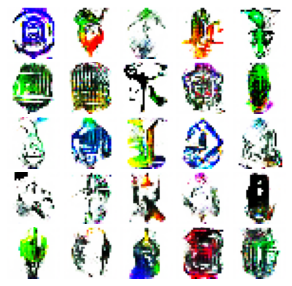

Saving GAN to ./logos_checkpoints2, epoch No. 256
Epoch: 257, Iter: 460, D: 0.08074766397476196, G:0.3423928916454315


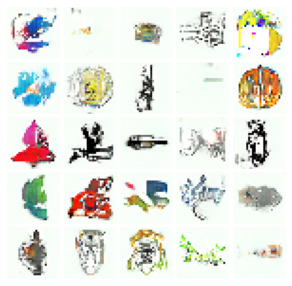

Saving GAN to ./logos_checkpoints2, epoch No. 257
Epoch: 258, Iter: 460, D: 0.08353385329246521, G:0.32407692074775696


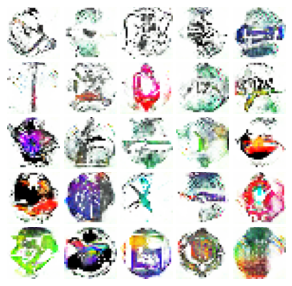

Saving GAN to ./logos_checkpoints2, epoch No. 258
Epoch: 259, Iter: 460, D: 0.09340402483940125, G:0.4142777919769287


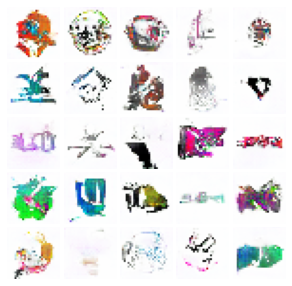

Saving GAN to ./logos_checkpoints2, epoch No. 259
Epoch: 260, Iter: 460, D: 0.08115161955356598, G:0.35509681701660156


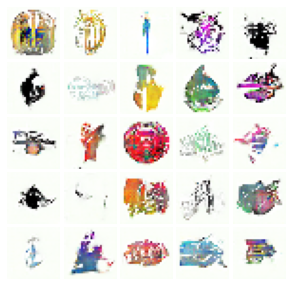

Saving GAN to ./logos_checkpoints2, epoch No. 260
Epoch: 261, Iter: 460, D: 0.07292690873146057, G:0.325863242149353


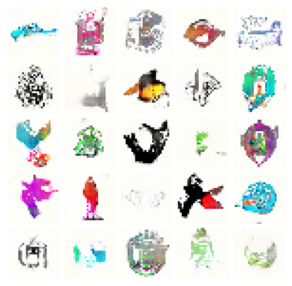

Saving GAN to ./logos_checkpoints2, epoch No. 261
Epoch: 262, Iter: 460, D: 0.0908491313457489, G:0.2775689959526062


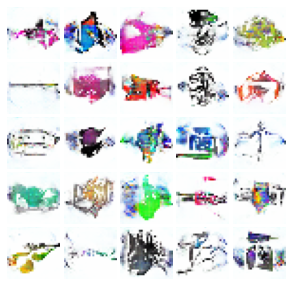

Saving GAN to ./logos_checkpoints2, epoch No. 262
Epoch: 263, Iter: 460, D: 0.07372236251831055, G:0.3459591865539551


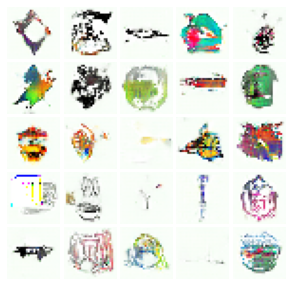

Saving GAN to ./logos_checkpoints2, epoch No. 263
Epoch: 264, Iter: 460, D: 0.07136127352714539, G:0.3460840582847595


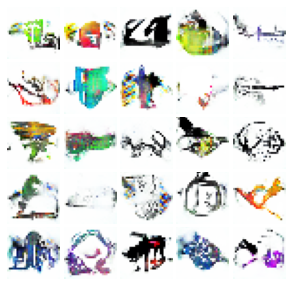

Saving GAN to ./logos_checkpoints2, epoch No. 264
Epoch: 265, Iter: 460, D: 0.1132308766245842, G:0.3196045160293579


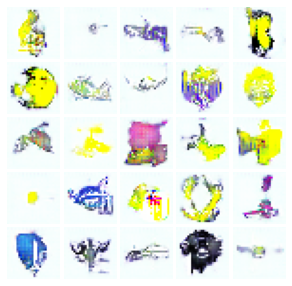

Saving GAN to ./logos_checkpoints2, epoch No. 265
Epoch: 266, Iter: 460, D: 0.07232248783111572, G:0.4030897617340088


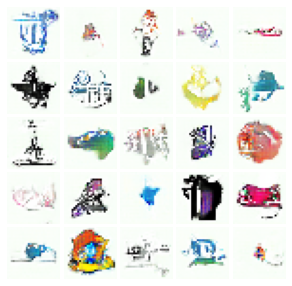

Saving GAN to ./logos_checkpoints2, epoch No. 266
Epoch: 267, Iter: 460, D: 0.0743403211236, G:0.35895490646362305


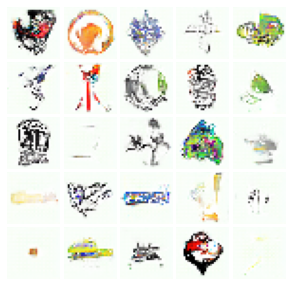

Saving GAN to ./logos_checkpoints2, epoch No. 267
Epoch: 268, Iter: 460, D: 0.07791943103075027, G:0.3204747438430786


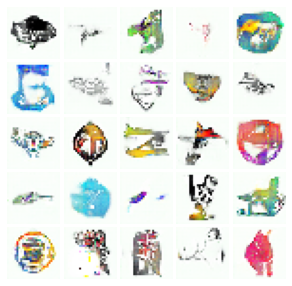

Saving GAN to ./logos_checkpoints2, epoch No. 268
Epoch: 269, Iter: 460, D: 0.08529578149318695, G:0.3217100501060486


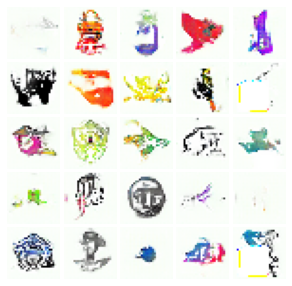

Saving GAN to ./logos_checkpoints2, epoch No. 269
Epoch: 270, Iter: 460, D: 0.09623406827449799, G:0.26241281628608704


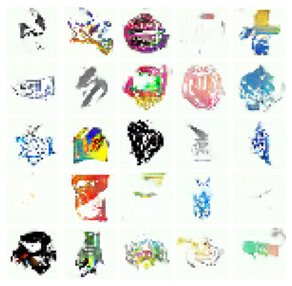

Saving GAN to ./logos_checkpoints2, epoch No. 270
Epoch: 271, Iter: 460, D: 0.09383389353752136, G:0.4181876480579376


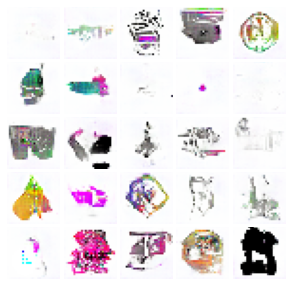

Saving GAN to ./logos_checkpoints2, epoch No. 271
Epoch: 272, Iter: 460, D: 0.07623063027858734, G:0.364327609539032


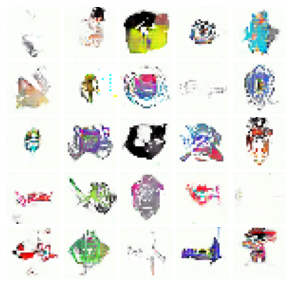

Saving GAN to ./logos_checkpoints2, epoch No. 272
Epoch: 273, Iter: 460, D: 0.07265905290842056, G:0.3943483531475067


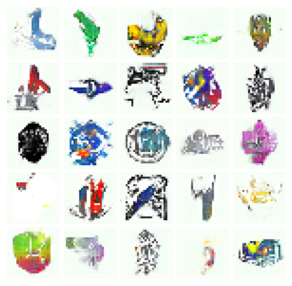

Saving GAN to ./logos_checkpoints2, epoch No. 273
Epoch: 274, Iter: 460, D: 0.07784537971019745, G:0.37713316082954407


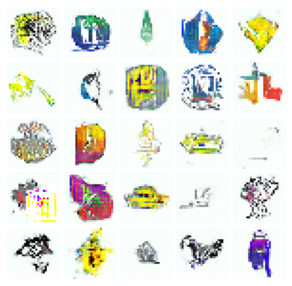

Saving GAN to ./logos_checkpoints2, epoch No. 274
Epoch: 275, Iter: 460, D: 0.08527330309152603, G:0.49049222469329834


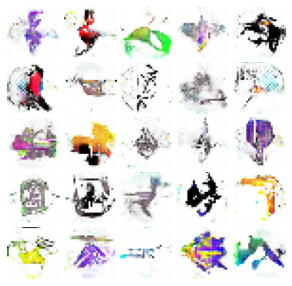

Saving GAN to ./logos_checkpoints2, epoch No. 275
Epoch: 276, Iter: 460, D: 0.079238161444664, G:0.39556246995925903


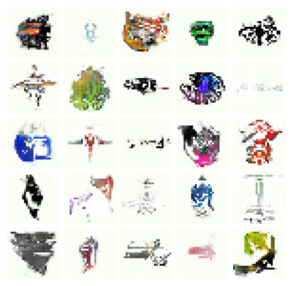

Saving GAN to ./logos_checkpoints2, epoch No. 276
Epoch: 277, Iter: 460, D: 0.08340352773666382, G:0.41158372163772583


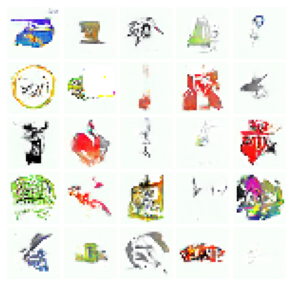

Saving GAN to ./logos_checkpoints2, epoch No. 277
Epoch: 278, Iter: 460, D: 0.07863514125347137, G:0.4118388891220093


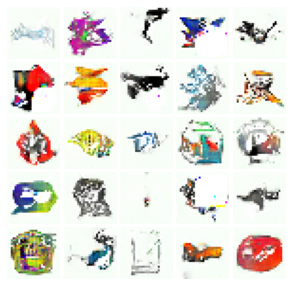

Saving GAN to ./logos_checkpoints2, epoch No. 278
Epoch: 279, Iter: 460, D: 0.0787777230143547, G:0.40088194608688354


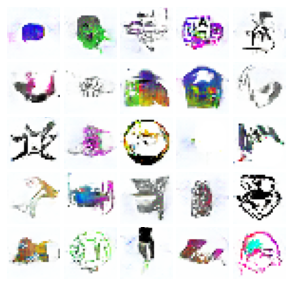

Saving GAN to ./logos_checkpoints2, epoch No. 279
Epoch: 280, Iter: 460, D: 0.0712146908044815, G:0.4215512275695801


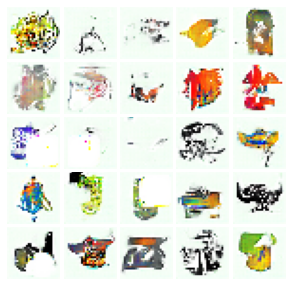

Saving GAN to ./logos_checkpoints2, epoch No. 280
Epoch: 281, Iter: 460, D: 0.0986049473285675, G:0.3420879542827606


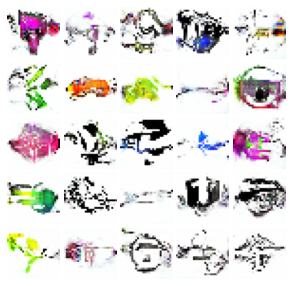

Saving GAN to ./logos_checkpoints2, epoch No. 281
Epoch: 282, Iter: 460, D: 0.07152925431728363, G:0.3551843464374542


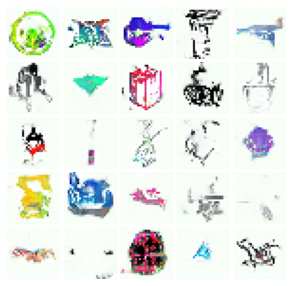

Saving GAN to ./logos_checkpoints2, epoch No. 282
Epoch: 283, Iter: 460, D: 0.08384952694177628, G:0.34217795729637146


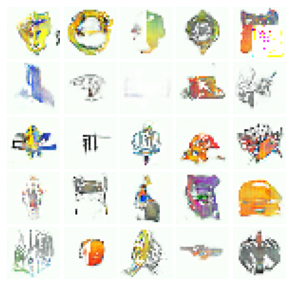

Saving GAN to ./logos_checkpoints2, epoch No. 283
Epoch: 284, Iter: 460, D: 0.07923242449760437, G:0.38379573822021484


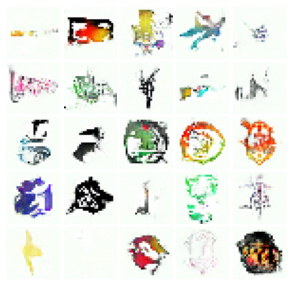

Saving GAN to ./logos_checkpoints2, epoch No. 284
Epoch: 285, Iter: 460, D: 0.0689375102519989, G:0.39688852429389954


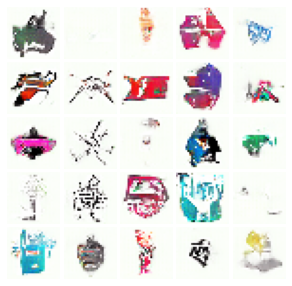

Saving GAN to ./logos_checkpoints2, epoch No. 285
Epoch: 286, Iter: 460, D: 0.1033208966255188, G:0.43303653597831726


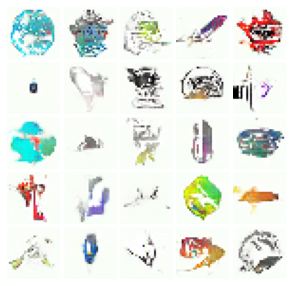

Saving GAN to ./logos_checkpoints2, epoch No. 286
Epoch: 287, Iter: 460, D: 0.07212988287210464, G:0.3460160791873932


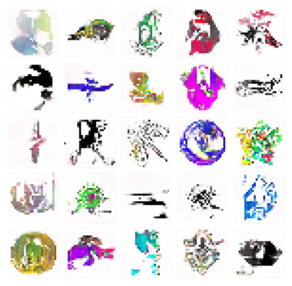

Saving GAN to ./logos_checkpoints2, epoch No. 287
Epoch: 288, Iter: 460, D: 0.11353462189435959, G:0.4691143333911896


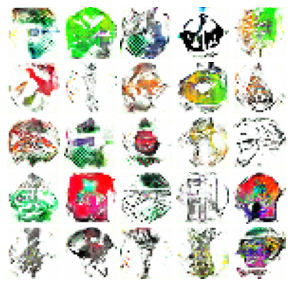

Saving GAN to ./logos_checkpoints2, epoch No. 288
Epoch: 289, Iter: 460, D: 0.07680579274892807, G:0.47109606862068176


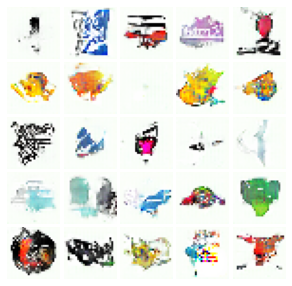

Saving GAN to ./logos_checkpoints2, epoch No. 289
Epoch: 290, Iter: 460, D: 0.10654673725366592, G:0.29620203375816345


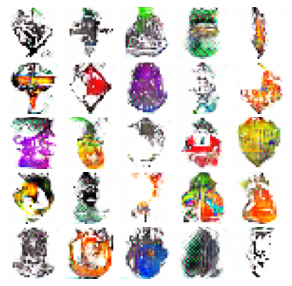

Saving GAN to ./logos_checkpoints2, epoch No. 290
Epoch: 291, Iter: 460, D: 0.08574032038450241, G:0.34000980854034424


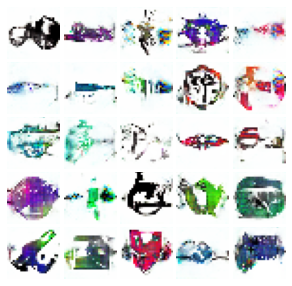

Saving GAN to ./logos_checkpoints2, epoch No. 291
Epoch: 292, Iter: 460, D: 0.08290509879589081, G:0.44368523359298706


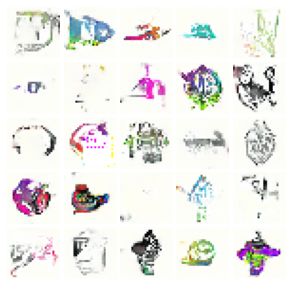

Saving GAN to ./logos_checkpoints2, epoch No. 292
Epoch: 293, Iter: 460, D: 0.07938478142023087, G:0.3829411566257477


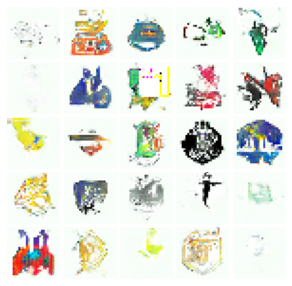

Saving GAN to ./logos_checkpoints2, epoch No. 293
Epoch: 294, Iter: 460, D: 0.0885031521320343, G:0.3453759551048279


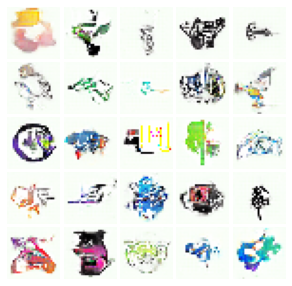

Saving GAN to ./logos_checkpoints2, epoch No. 294
Epoch: 295, Iter: 460, D: 0.09285236150026321, G:0.3607965111732483


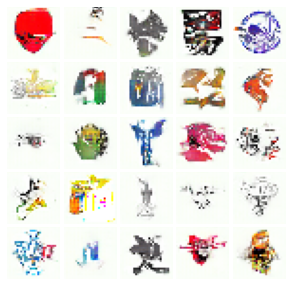

Saving GAN to ./logos_checkpoints2, epoch No. 295
Epoch: 296, Iter: 460, D: 0.13396728038787842, G:0.2436026930809021


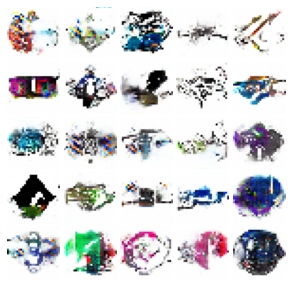

Saving GAN to ./logos_checkpoints2, epoch No. 296
Epoch: 297, Iter: 460, D: 0.08256171643733978, G:0.3416474163532257


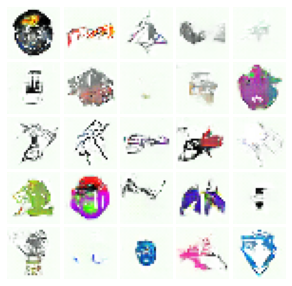

Saving GAN to ./logos_checkpoints2, epoch No. 297
Epoch: 298, Iter: 460, D: 0.06543917953968048, G:0.3736647367477417


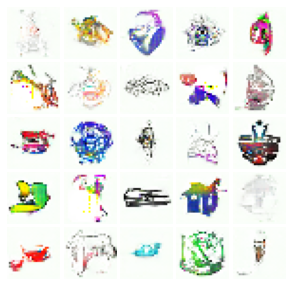

Saving GAN to ./logos_checkpoints2, epoch No. 298
Epoch: 299, Iter: 460, D: 0.08589757233858109, G:0.2837783098220825


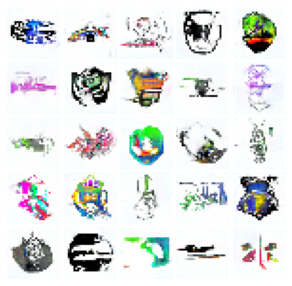

Saving GAN to ./logos_checkpoints2, epoch No. 299


In [205]:
# This loop was not started from 0 it. that is why 
# from the very first epoch fakes looks logo-like
# fakes progression images ore provided in the folder
with tf.device(device):
    album_gan.train(train_data=train_ds, num_epochs=300, 
                    show_every=460, cp_path='./lch_new')

In [27]:
# See how many iteratioms were done:
album_gan.G_solver.iterations

<tf.Variable 'iter:0' shape=() dtype=int64, numpy=238000>

# Generate logos with trained model:

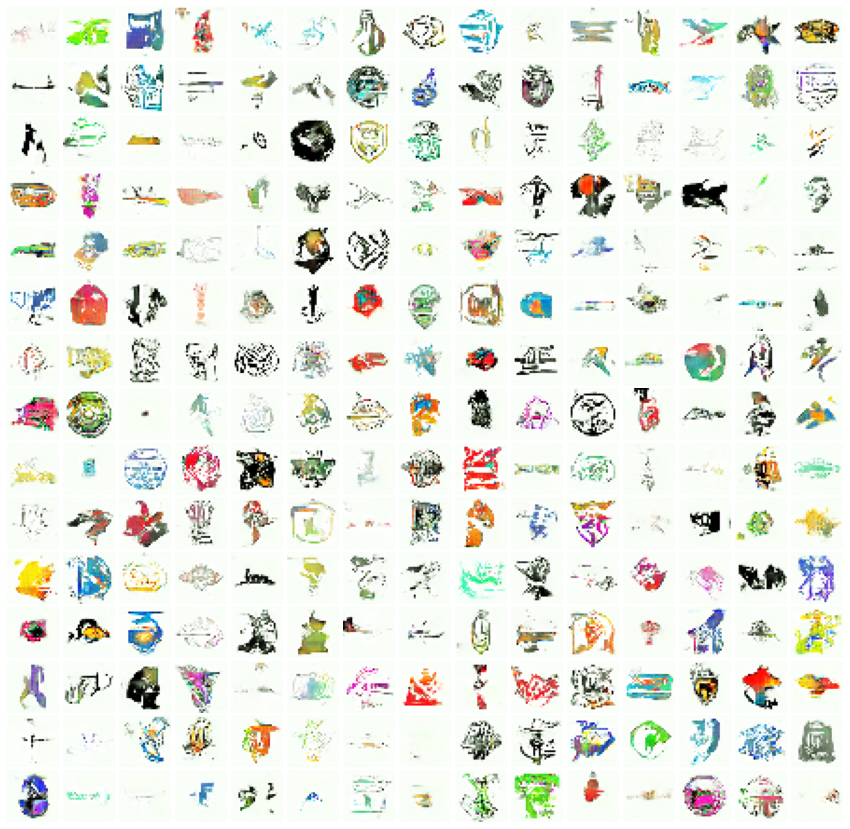

In [28]:
n_gen_logos = 15**2
# Sample latent variable input:
random_noise = tf.random.uniform([n_gen_logos, NOISE_DIM, NOISE_DIM, NOISE_C], minval=-1.0, maxval=1.0)
# Generate logos with G:
gen_pics = album_gan.G(random_noise, training=False)
# Show the result:
show_tf_batch(gen_pics, n_img=n_gen_logos)